In [1]:
# %load_ext autoreload
# %autoreload 2

In [207]:
import os, sys
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import h5py
import scipy
import pandas
import anndata
import tangram
import json
from sklearn.neighbors import NearestNeighbors

from IPython.display import Audio
tada = 'C://Users/stephanies/tada.mp3'

from celltype_mapping import TangramMapping, bin_gene_table, convert_to_anndata

In [2]:
sys.path.append(os.getcwd() + '/../gene_panel_selection')
sys.path.append(os.getcwd() + '/../segmentation')

from segmentation import SpotTable
from gene_panel_selection import ExpressionDataset

Relevant code for loading raw(ish) data and convering to anndata for use with tangram. Suggest that these data be saved for later loading if they will be reused as they are large and this takes some time. If you've already done this skip down...

In [3]:
# base network data path
data_path = '//allen/programs/celltypes/workgroups/rnaseqanalysis'

# raw spatial data

sp_data_path = data_path + '/NHP_spatial/MERSCOPE/macaque/1191380959/region_0/mtg'
sp_csv_file = sp_data_path + '/detected_transcripts.csv'
sp_cache_file = sp_data_path + '/detected_transcripts.npz'

# spatial AnnData file
sp_anndata_file = sp_data_path + '/macaque-merscope-cellpose-filtered.h5ad'

# raw single cell data
sc_data_path = data_path + '/Nik/Analyses_for_great_apes_paper/Shiny_obj_final/rhesus'
rnaSeq_data_file = sc_data_path + '/data.feather'
rnaSeq_anno_file = sc_data_path + '/anno.feather'

# single cell AnnData file
sc_anndata_file = data_path + '/NHP_spatial/snRNAseq_data/macaque_MTG_logcpm.h5ad'

# path for storing tangram mapping
tg_mapping_path = sp_data_path + '/mapping'

In [4]:
with open('//allen/programs/celltypes/workgroups/rnaseqanalysis/NHP_spatial/snRNAseq_data/ordered_celltype_labels.json') as file:
            ordered_labels = json.load(file)

In [117]:
meta = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667515701.735', meta_only=True)
meta

{'snRNAseq': 'logcpm',
 'snRNAseq_region': 'MTG',
 'spatial_method': 'MERSCOPE',
 'spatial_region': 'MTG',
 'segmentation': 'cellpose_cyto2_nuclei',
 'segmentation_filters': {'volume': [100, 3500],
  'n_genes': [20, 420],
  'n_spots': [100, 3500]},
 'merscope_barcode': 1191380959,
 'training_genes': 'subclass marker genes panel',
 'mode': 'clusters',
 'cluster_label': 'cluster'}

In [5]:
tg_vzg600 = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1666822812.002')
print(tg_vzg600.meta['training_genes'], tg_vzg600.meta['cluster_label'])
tg_gb = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667254420.423')
print(tg_gb.meta['training_genes'], tg_gb.meta['cluster_label'])
tg_propose = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667258940.105')
print(tg_propose.meta['training_genes'], tg_propose.meta['cluster_label'])
tg_mfishtools = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667508639.940')
print(tg_mfishtools.meta['training_genes'], tg_mfishtools.meta['cluster_label'])
tg_zde = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667335194.424')
print(tg_zde.meta['training_genes'], tg_zde.meta['cluster_label'])
tg_marker = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667338211.240')
print(tg_marker.meta['training_genes'], tg_marker.meta['cluster_label'])
tg_wb = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667340989.678')
print(tg_wb.meta['training_genes'], tg_wb.meta['cluster_label'])

VZG600 panel subclass
cortical geneBasis panel subclass
cortical PROPOSE panel subclass
mFISHtools panel subclass
cortical Zizhen/DE genes panel subclass
cortical marker genes panel subclass
whole brain panel subclass


In [29]:
panel_mappings_subclass = {
    'full panel': tg_vzg600,
    'geneBasis-cortical': tg_gb,
    'PROPOSE': tg_propose,
    'mFISHtools': tg_mfishtools,
    'Zizhen/DE genes': tg_zde,
    'marker genes': tg_marker,
    'geneBasis-whole brain': tg_wb
}

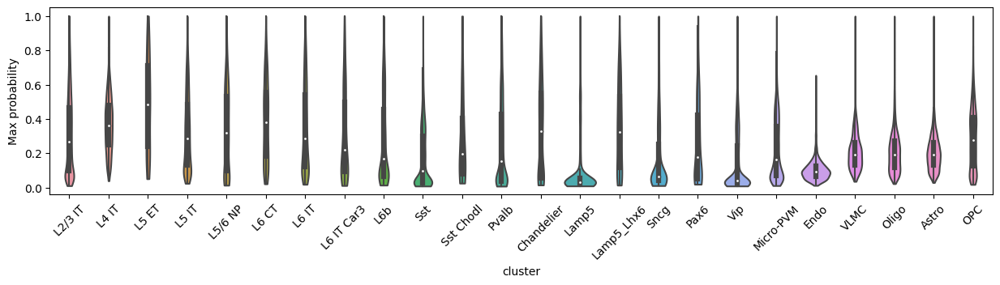

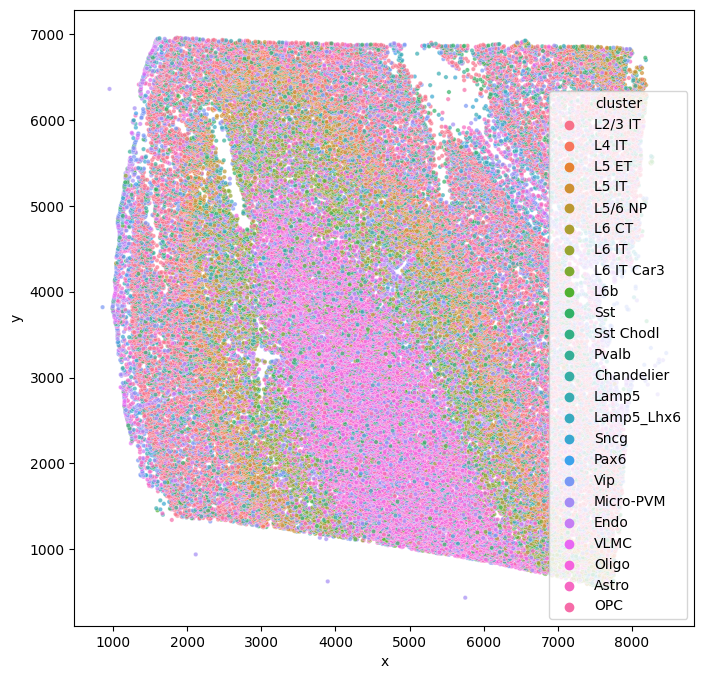

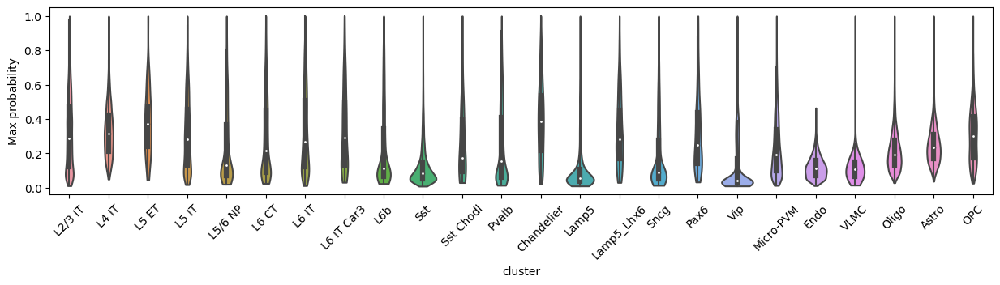

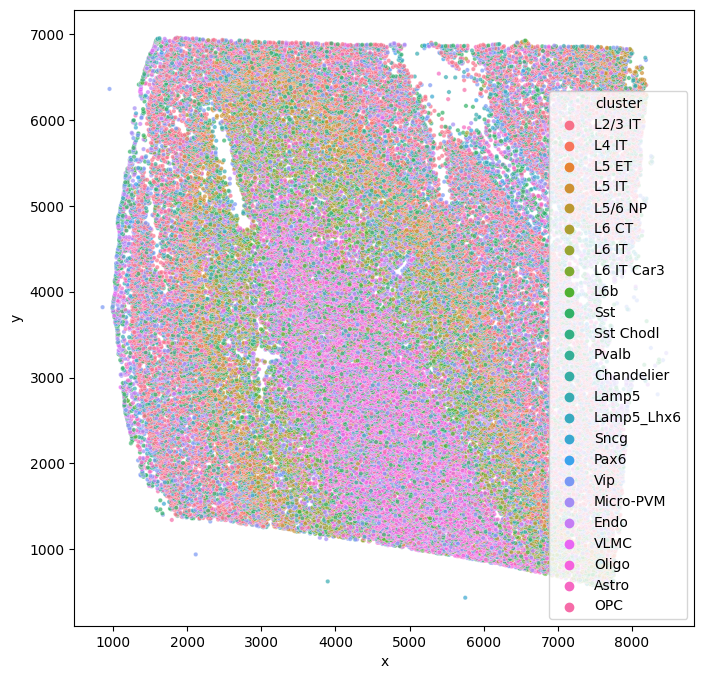

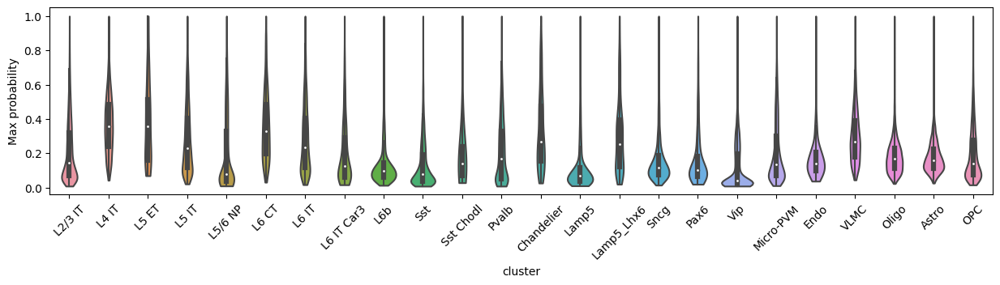

...

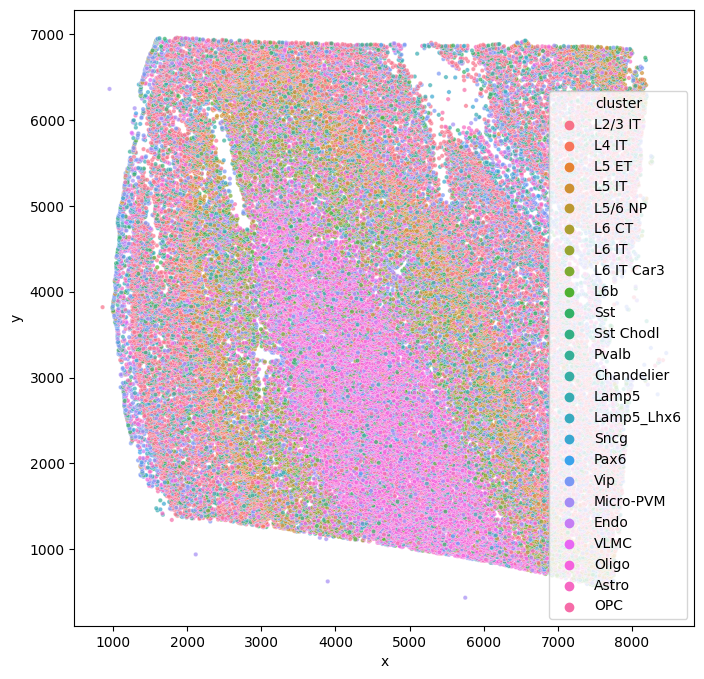

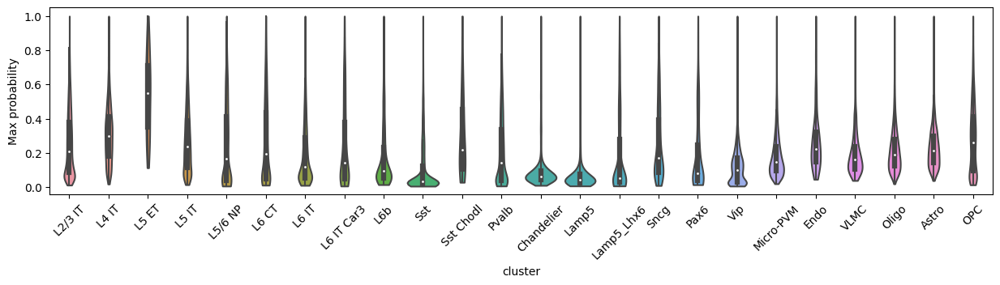

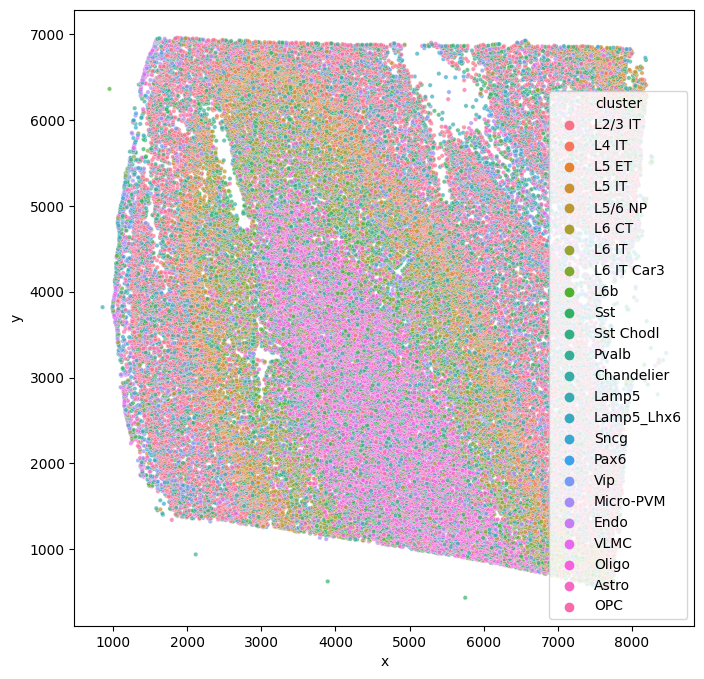

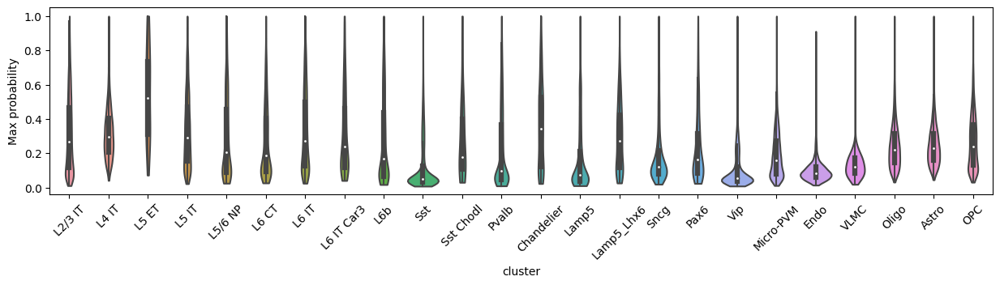

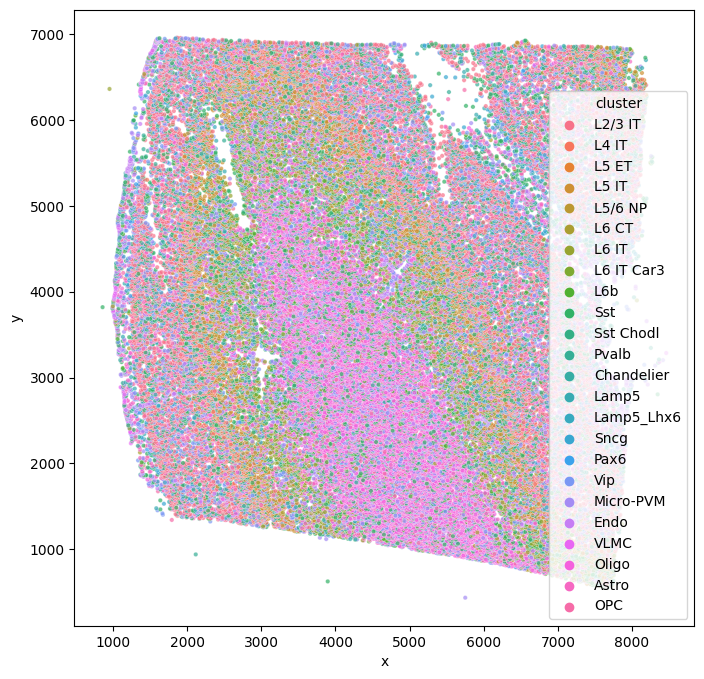

In [14]:
for mapping in panel_mappings_subclass.values():
    mapping.get_discrete_cell_mapping()
    mapping.plot_discrete_mapping()

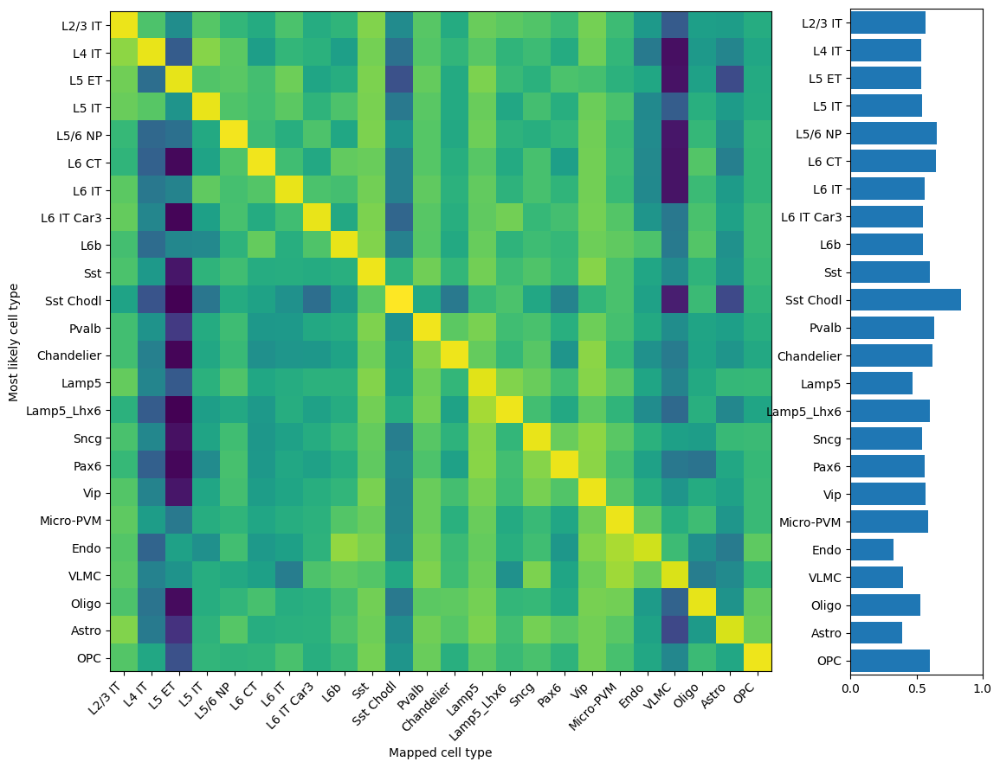

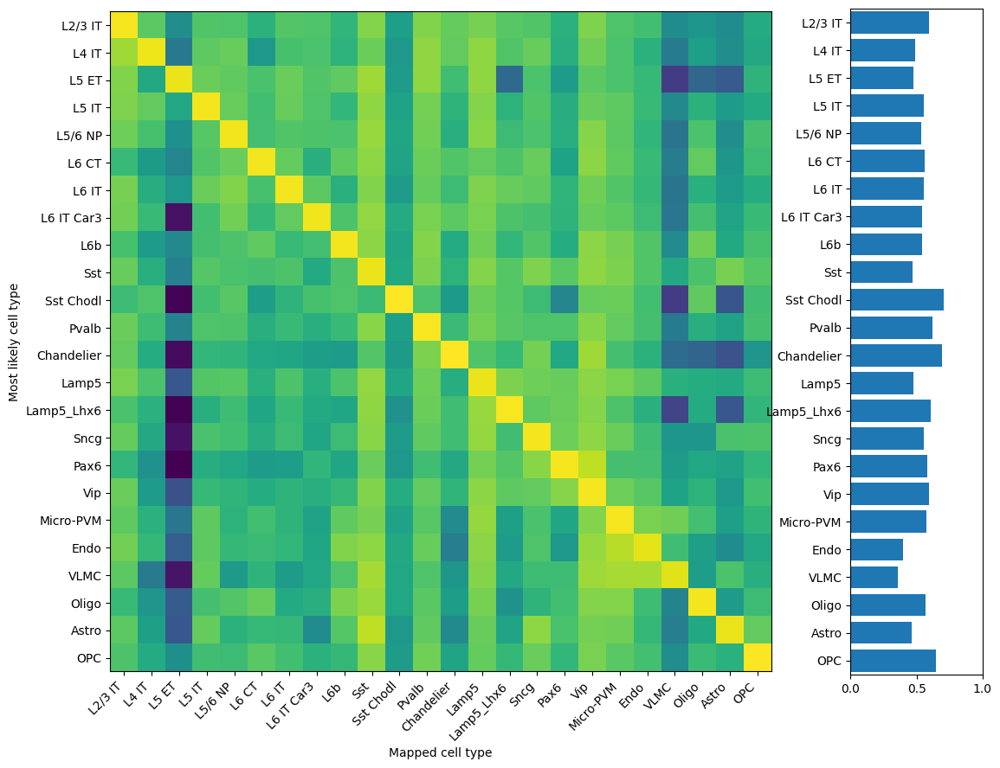

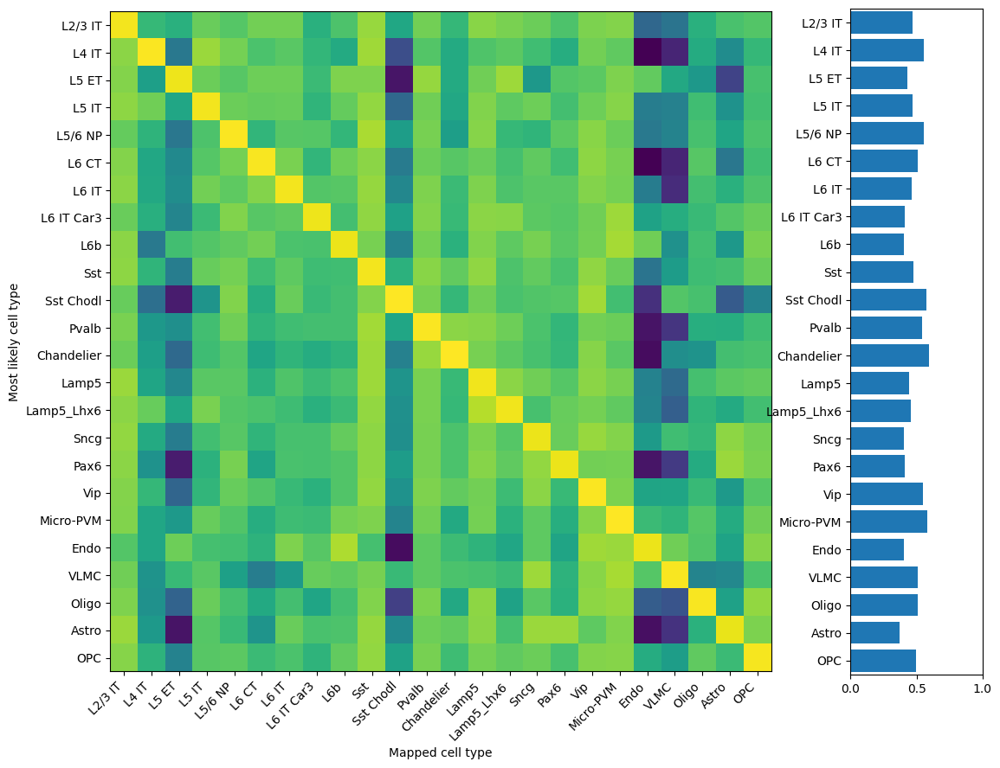

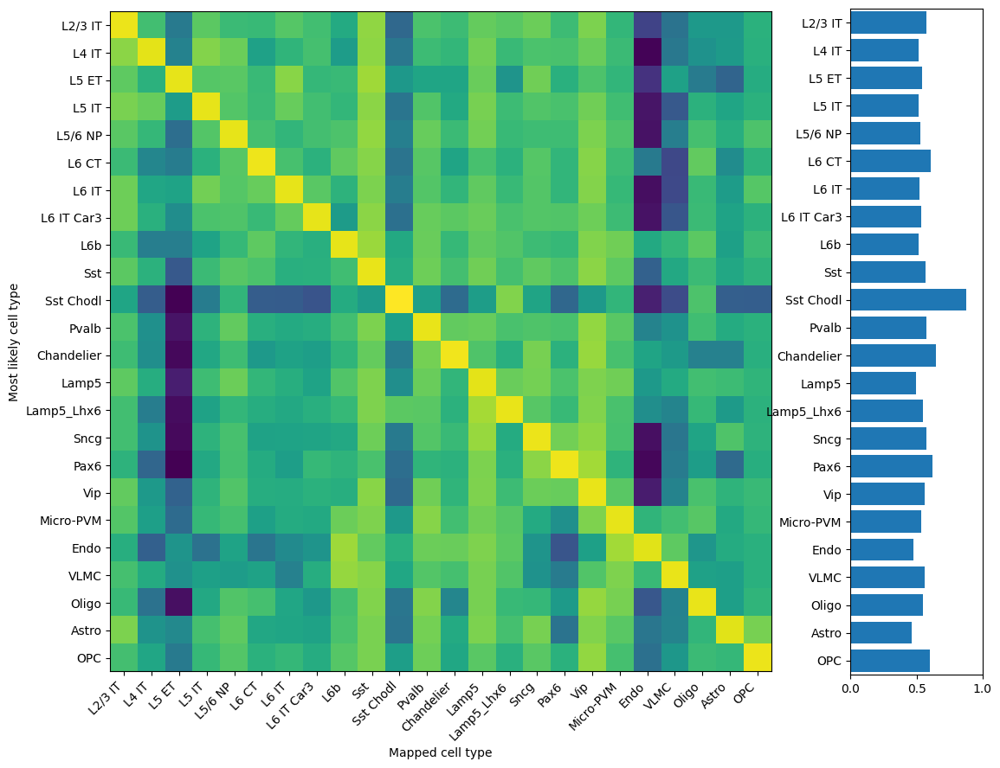

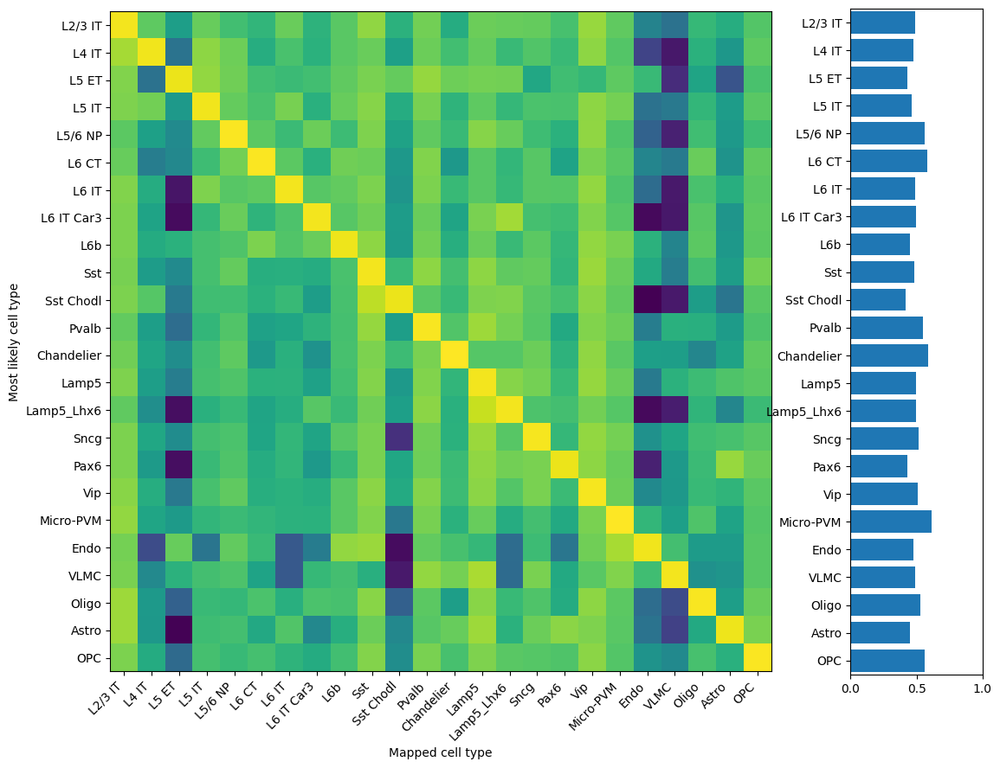

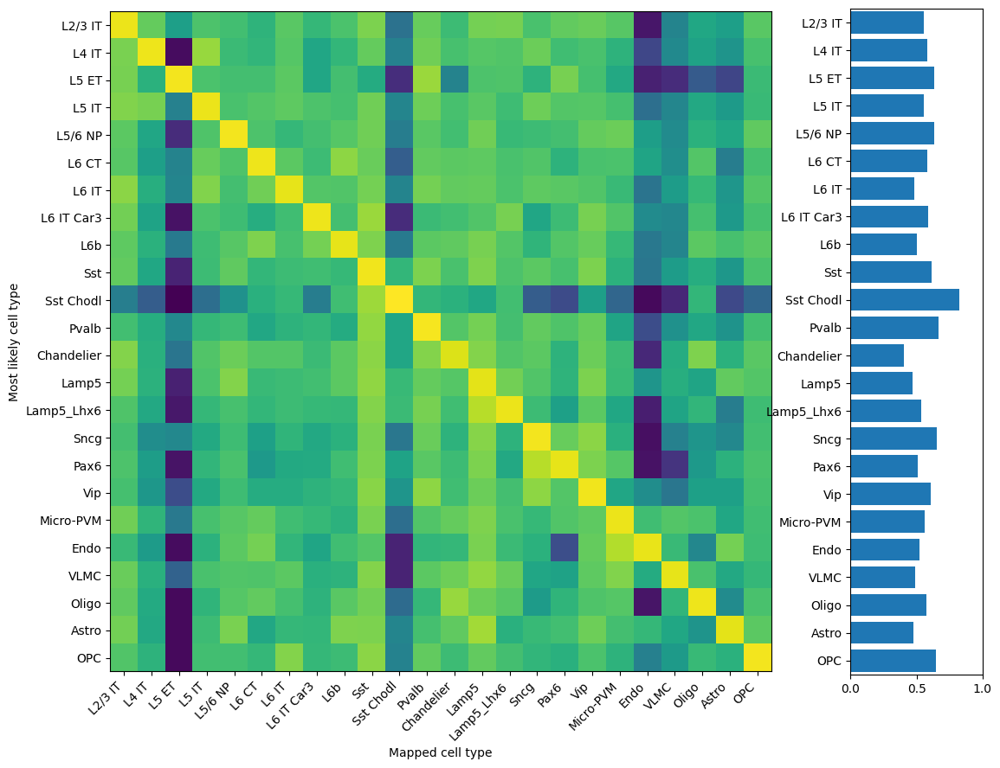

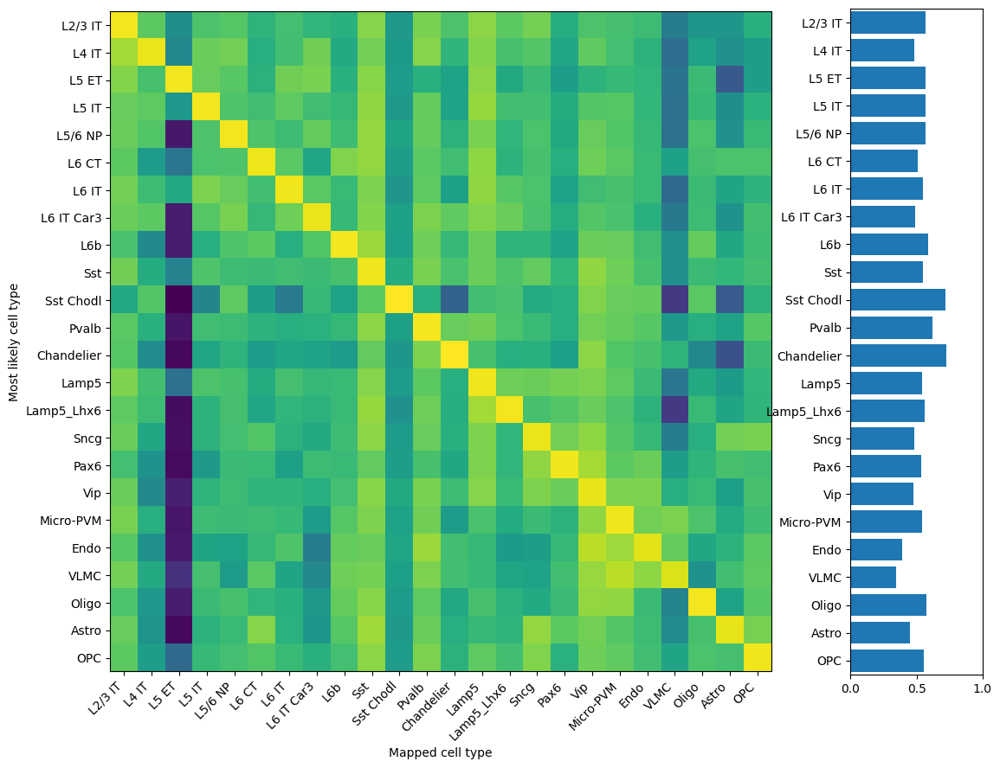

In [8]:
for mapping in panel_mappings_subclass.values():
    mapping.get_confusion_matrix()

In [30]:
all_panel_mapping_subclass = pd.DataFrame(tg_vzg600.ad_sp.obs.index)
all_panel_mapping_subclass.set_index('cell', inplace=True)
all_panel_mapping_subclass

""
cell
1019095826100270249
1019095826100300124
1019095826100310136
1019095826100310139
1019095826100310140
...
1019095826202810044
1019095826202810050
1019095826202820029


In [31]:
for name, mapping in panel_mappings_subclass.items():
    prob_mapping = mapping.ad_sp.obsm['discrete_ct_pred'][['cluster_prop', 'cluster']]
    prob_mapping.rename(columns={'cluster_prop': name + '_prob', 'cluster': name + '_cluster'}, inplace=True)
    all_panel_mapping_subclass = all_panel_mapping_subclass.merge(prob_mapping, left_index=True, right_index=True)
    
all_panel_mapping_subclass.head()

,full panel_prob,full panel_cluster,geneBasis-cortical_prob,geneBasis-cortical_cluster,PROPOSE_prob,PROPOSE_cluster,mFISHtools_prob,mFISHtools_cluster,Zizhen/DE genes_prob,Zizhen/DE genes_cluster,marker genes_prob,marker genes_cluster,geneBasis-whole brain_prob,geneBasis-whole brain_cluster
cell,,,,,,,,,,,,,,
1019095826100270249,0.356975,Micro-PVM,0.040643,Lamp5,0.270356,Micro-PVM,0.031325,L5/6 NP,0.631851,Micro-PVM,0.014683,Sst,0.031934,Sst
1019095826100300124,0.088328,Micro-PVM,0.035065,Sncg,0.019076,Sst,0.027539,Micro-PVM,0.090620,Micro-PVM,0.011656,Sst,0.168016,Micro-PVM
1019095826100310136,0.240196,Oligo,0.151584,Oligo,0.187323,Oligo,0.210443,Oligo,0.225494,Oligo,0.207885,Oligo,0.341141,Oligo
1019095826100310139,0.228403,Oligo,0.188221,Oligo,0.229900,Oligo,0.209149,Oligo,0.171089,Oligo,0.225509,Oligo,0.245972,Oligo
1019095826100310140,0.296514,Astro,0.119037,Astro,0.296925,Astro,0.163156,Astro,0.342696,Astro,0.282144,Astro,0.285652,Astro


In [32]:
cluster_cols = [c for c in all_panel_mapping_subclass.columns if c.endswith('_cluster')]
prob_cols = [c for c in all_panel_mapping_subclass.columns if c.endswith('_prob')]
all_panel_mapping_subclass['n_types'] = all_panel_mapping_subclass.apply(lambda x: len(x[cluster_cols].unique()), axis=1)
all_panel_mapping_subclass['avg_prob'] = all_panel_mapping_subclass.apply(lambda x: x[prob_cols].mean(), axis=1)
all_panel_mapping_subclass['cv_prob'] = all_panel_mapping_subclass.apply(lambda x: x[prob_cols].std() / x[prob_cols].mean(), axis=1)                                                

In [33]:
mapping_stats = all_panel_mapping_subclass[['n_types', 'avg_prob', 'cv_prob']]
all_panel_mapping_subclass.drop(columns=['n_types', 'avg_prob', 'cv_prob'], inplace=True)
mapping_stats.head()

,n_types,avg_prob,cv_prob
cell,,,
1019095826100270249,4,0.196824,1.195941
1019095826100300124,3,0.062900,0.895494
1019095826100310136,1,0.223438,0.264884
1019095826100310139,1,0.214035,0.122791
1019095826100310140,1,0.255160,0.319069


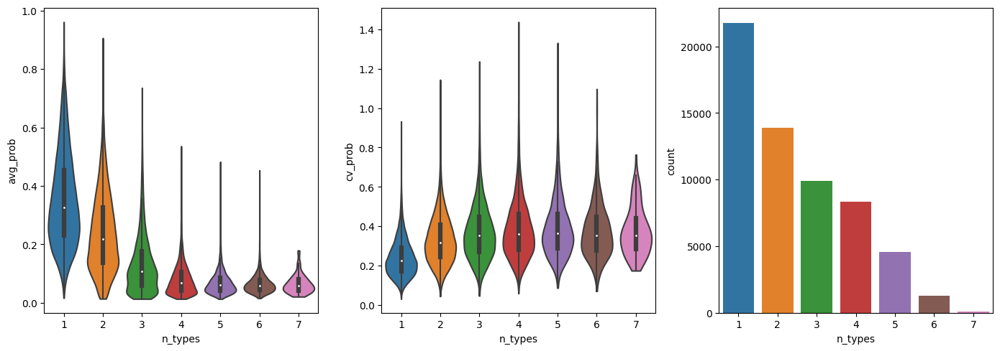

In [19]:
fig, ax = plt.subplots(1, 3, figsize=(14, 5))
sns.violinplot(data=mapping_stats, x='n_types', y='avg_prob', ax=ax[0], cut=0, scale='width')
sns.violinplot(data=mapping_stats, x='n_types', y='cv_prob', ax=ax[1], cut=0, scale='width')
sns.countplot(data=mapping_stats, x='n_types', ax=ax[2])
plt.tight_layout()

In [34]:
subclasses = all_panel_mapping_subclass.melt(ignore_index=False, id_vars=prob_cols, var_name='panel', value_name='cluster')
subclasses =  subclasses.reset_index()
subclasses = subclasses[['cell', 'panel', 'cluster']]

subclasses_prob = all_panel_mapping_subclass.melt(ignore_index=False, id_vars=cluster_cols, var_name='panel', value_name='cluster_prob')
subclasses_prob = subclasses_prob.reset_index()
subclasses_prob = subclasses_prob[['cell', 'panel', 'cluster_prob']]

subclasses = subclasses.merge(subclasses_prob[['cell', 'panel', 'cluster_prob']], left_index=True, right_index=True)
subclasses['panel'] = subclasses.apply(lambda x: x['panel_y'].split('_')[0], axis=1)
subclasses['cell'] = subclasses.apply(lambda x: x['cell_y'] if x['cell_y']==x['cell_x'] else np.nan(), axis=1)
print(sum(subclasses['cell'].isna()))

subclasses = subclasses[['cell', 'panel', 'cluster', 'cluster_prob']]
subclasses.set_index('cell', inplace=True)
subclasses.head()

0


,panel,cluster,cluster_prob
cell,,,
1019095826100270249,full panel,Micro-PVM,0.356975
1019095826100300124,full panel,Micro-PVM,0.088328
1019095826100310136,full panel,Oligo,0.240196
1019095826100310139,full panel,Oligo,0.228403
1019095826100310140,full panel,Astro,0.296514


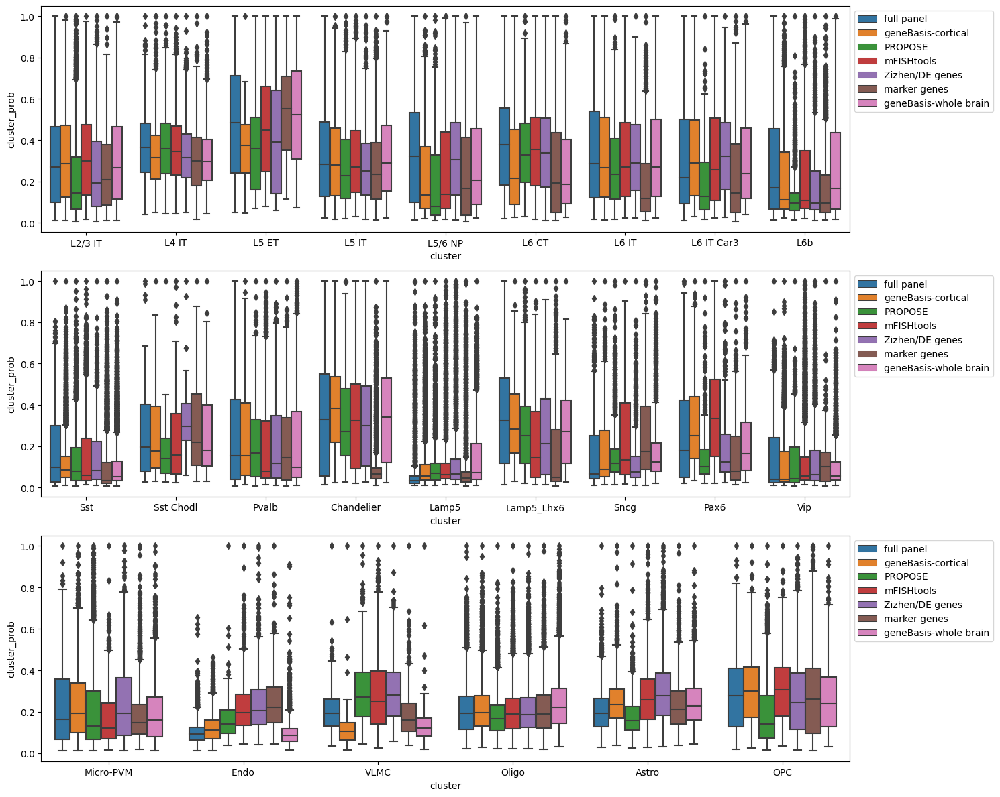

In [35]:
fig, ax = plt.subplots(3, 1, figsize=(15, 12))

exc = ('L2/3 IT', 'L4 IT', 'L5 ET', 'L5 IT', 'L5/6 NP', 'L6 CT', 'L6 IT', 'L6 IT Car3', 'L6b')
inh = ('Sst', 'Sst Chodl', 'Pvalb', 'Chandelier', 'Lamp5', 'Lamp5_Lhx6', 'Sncg', 'Pax6', 'Vip')
glia = ('Micro-PVM', 'Endo', 'VLMC', 'Oligo', 'Astro', 'OPC')

for i, group in enumerate([exc, inh, glia]):
        sns.boxplot(data=subclasses[subclasses['cluster'].isin(group)], x='cluster', y='cluster_prob', hue='panel', ax=ax[i], order=group)
        ax[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
        
plt.tight_layout()

In [36]:
def set_class(row):
    if row['cluster'] in exc:
        return 'exc'
    if row['cluster'] in inh:
        return 'inh'
    if row['cluster'] in glia:
        return 'glia'
    
subclasses['class'] = subclasses.apply(lambda x: set_class(x), axis=1)
subclasses.head()

,panel,cluster,cluster_prob,class
cell,,,,
1019095826100270249,full panel,Micro-PVM,0.356975,glia
1019095826100300124,full panel,Micro-PVM,0.088328,glia
1019095826100310136,full panel,Oligo,0.240196,glia
1019095826100310139,full panel,Oligo,0.228403,glia
1019095826100310140,full panel,Astro,0.296514,glia


In [42]:
subclasses.groupby(['class', 'panel']).describe().sort_values(('cluster_prob', 'mean'), ascending=False)

cluster_prob                                \
                                   count      mean       std       min   
class panel                                                              
exc   full panel                 20103.0  0.323986  0.218198  0.010426   
      mFISHtools                 18911.0  0.319062  0.208475  0.016241   
      geneBasis-whole brain      19360.0  0.308042  0.208449  0.011251   
      geneBasis-cortical         19336.0  0.306755  0.208201  0.011744   
      Zizhen/DE genes            20399.0  0.274331  0.189953  0.008984   
      marker genes               22841.0  0.251268  0.190855  0.006337   
      PROPOSE                    22981.0  0.249022  0.190962  0.008305   
glia  Zizhen/DE genes            23889.0  0.242510  0.148528  0.012540   
      mFISHtools                 23194.0  0.225784  0.135551  0.015638   
      geneBasis-cortical         21381.0  0.221365  0.139151  0.012231   
      marker genes               18264.0  0.219647  0.140158  0.013477   
      geneBasis-whole brain      22935.0  0.215809  0.135350  0.011815   
      full panel                 25165.0  0.206259  0.135210  0.011081   
      PROPOSE                    21714.0  0.193118  0.137870  0.010766   
inh   full panel                 14604.0  0.169107  0.197112  0.007699   
      mFISHtools                 17767.0  0.167122  0.194454  0.012022   
      Zizhen/DE genes            15584.0  0.161203  0.177252  0.008604   
      geneBasis-whole brain      17577.0  0.151048  0.174290  0.008082   
      PROPOSE                    15177.0  0.150615  0.154718  0.007877   
      geneBasis-cortical         19155.0  0.149697  0.163575  0.009076   
      marker genes               18767.0  0.123840  0.160115  0.005753   

                                                                
                                  25%       50%       75%  max  
class panel                                                     
exc   full panel             0.126213  0.298424  0.485394  1.0  
      mFISHtools             0.136310  0.289255  0.466544  1.0  
      geneBasis-whole brain  0.128688  0.270525  0.450586  1.0  
      geneBasis-cortical     0.122844  0.273744  0.453199  1.0  
      Zizhen/DE genes        0.105273  0.243130  0.408604  1.0  
      marker genes           0.083017  0.210641  0.378459  1.0  
      PROPOSE                0.087802  0.198816  0.376039  1.0  
glia  Zizhen/DE genes        0.127721  0.215168  0.327737  1.0  
      mFISHtools             0.117458  0.204251  0.305060  1.0  
      geneBasis-cortical     0.117359  0.190999  0.296171  1.0  
      marker genes           0.114028  0.189203  0.294018  1.0  
      geneBasis-whole brain  0.109531  0.189582  0.296248  1.0  
      full panel             0.098047  0.179728  0.283747  1.0  
      PROPOSE                0.093522  0.158276  0.253207  1.0  
inh   full panel             0.026249  0.054475  0.290490  1.0  
      mFISHtools             0.038319  0.065022  0.251015  1.0  
      Zizhen/DE genes        0.039312  0.078500  0.236036  1.0  
      geneBasis-whole brain  0.038317  0.068335  0.204644  1.0  
      PROPOSE                0.037953  0.090778  0.216755  1.0  
      geneBasis-cortical     0.040173  0.078593  0.196817  1.0  
      marker genes           0.026014  0.053932  0.143283  1.0

In [38]:
subclasses.groupby('panel').describe().sort_values(('cluster_prob', 'mean'), ascending=False)

cluster_prob                                          \
                             count      mean       std       min       25%   
panel                                                                        
mFISHtools                 59872.0  0.237839  0.188917  0.012022  0.077769   
full panel                 59872.0  0.236726  0.192894  0.007699  0.074025   
Zizhen/DE genes            59872.0  0.232188  0.176725  0.008604  0.083937   
geneBasis-whole brain      59872.0  0.226621  0.183983  0.008082  0.076213   
geneBasis-cortical         59872.0  0.226013  0.182894  0.009076  0.078446   
PROPOSE                    59872.0  0.203802  0.168824  0.007877  0.074175   
marker genes               59872.0  0.201680  0.175669  0.005753  0.058833   

                                                
                            50%       75%  max  
panel                                           
mFISHtools             0.192001  0.351343  1.0  
full panel             0.189233  0.353004  1.0  
Zizhen/DE genes        0.191642  0.339842  1.0  
geneBasis-whole brain  0.176441  0.328783  1.0  
geneBasis-cortical     0.173045  0.329448  1.0  
PROPOSE                0.151953  0.289934  1.0  
marker genes           0.147940  0.300734  1.0

In [242]:
subclass_median = subclasses.groupby(['cluster', 'panel']).median().unstack().loc(axis=0)[ordered_labels['subclass']]
subclass_median.columns = subclass_median.columns.droplevel(None)
subclass_median

panel,PROPOSE,Zizhen/DE genes,full panel,geneBasis-cortical,geneBasis-whole brain,mFISHtools,marker genes
cluster,,,,,,,
L2/3 IT,0.144501,0.193655,0.269391,0.287086,0.266298,0.298418,0.209491
L4 IT,0.358336,0.317369,0.363827,0.314551,0.297592,0.345092,0.299315
L5 ET,0.357608,0.390848,0.483880,0.373060,0.524158,0.447697,0.551985
L5 IT,0.228850,0.250728,0.284433,0.281034,0.291067,0.269634,0.235839
L5/6 NP,0.078287,0.304761,0.320735,0.133415,0.205387,0.138871,0.167431
L6 CT,0.328781,0.338811,0.378969,0.214394,0.186585,0.353462,0.193993
L6 IT,0.235362,0.290671,0.285656,0.266175,0.271156,0.268955,0.118705
L6 IT Car3,0.127356,0.322634,0.219620,0.290632,0.239434,0.256843,0.142370
L6b,0.096151,0.096238,0.169294,0.111879,0.166783,0.107925,0.094706


<AxesSubplot: xlabel='panel', ylabel='cluster'>

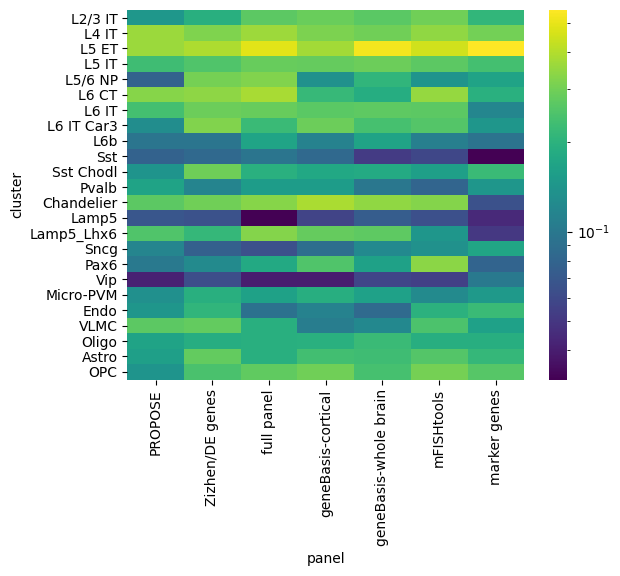

In [231]:
sns.heatmap(subclass_median, cmap='viridis', norm=LogNorm())

In [289]:
confusion = pd.DataFrame(index=exc + inh + glia)

for name, mapping in panel_mappings_subclass.items():
    diff = np.diag(mapping.confusion_matrix) / mapping.confusion_matrix.sum(axis=1)
    confusion[name] = diff
confusion.index.name = 'cluster'
confusion

,full panel,geneBasis-cortical,PROPOSE,mFISHtools,Zizhen/DE genes,marker genes,geneBasis-whole brain
cluster,,,,,,,
L2/3 IT,0.565654,0.592684,0.471235,0.573694,0.490041,0.555562,0.571155
L4 IT,0.536290,0.490989,0.556090,0.515214,0.473526,0.583026,0.480232
L5 ET,0.533712,0.476287,0.432432,0.539230,0.430328,0.636298,0.569893
L5 IT,0.544632,0.552416,0.473219,0.516742,0.466521,0.553427,0.566488
L5/6 NP,0.655531,0.534688,0.556983,0.526335,0.561439,0.631518,0.568318
L6 CT,0.645254,0.560044,0.511739,0.610338,0.583283,0.579376,0.506218
L6 IT,0.561561,0.552961,0.461096,0.523856,0.489483,0.482597,0.547884
L6 IT Car3,0.547202,0.541642,0.412344,0.534767,0.494040,0.588772,0.490504
L6b,0.548932,0.543197,0.406786,0.517142,0.450354,0.501538,0.588296


In [61]:
confusion.describe().T.sort_values('mean', ascending=False)

,count,mean,std,min,25%,50%,75%,max
marker genes,24.0,0.569797,0.086824,0.401951,0.505060,0.568284,0.616292,0.823873
mFISHtools,24.0,0.563151,0.079554,0.464658,0.522177,0.546921,0.574649,0.876663
full panel,24.0,0.558644,0.099677,0.327434,0.535646,0.563023,0.601650,0.837809
geneBasis-cortical,24.0,0.548079,0.082789,0.358942,0.487830,0.552725,0.593172,0.708332
geneBasis-whole brain,24.0,0.539692,0.083515,0.345270,0.488375,0.548600,0.570208,0.723452
Zizhen/DE genes,24.0,0.501869,0.052453,0.419191,0.471775,0.492950,0.535081,0.615493
PROPOSE,24.0,0.483644,0.065085,0.371787,0.427410,0.476140,0.544049,0.593691


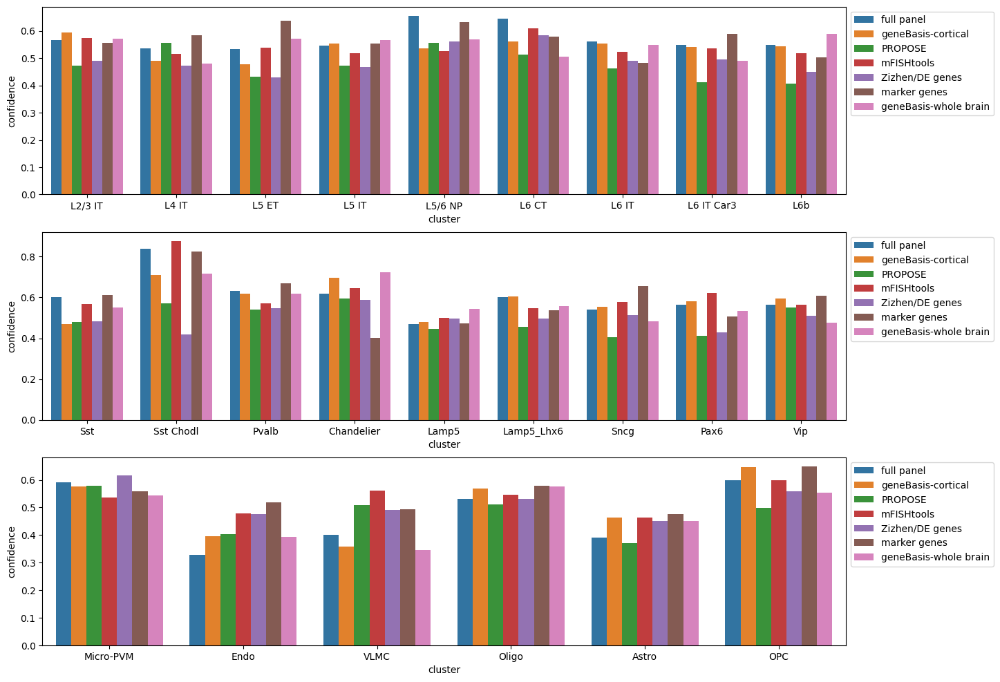

In [67]:
fig, ax = plt.subplots(3, 1, figsize=(15, 12))

for i, group in enumerate([exc, inh, glia]):
    data = confusion.loc(axis=0)[group].melt(ignore_index=False, var_name='panel', value_name='confidence').reset_index(names='cluster')
    sns.barplot(data=data, x='cluster', y='confidence', hue='panel', ax=ax[i], order=group)
    ax[i].legend(loc='upper left', bbox_to_anchor=(1, 1))

<AxesSubplot: ylabel='cluster'>

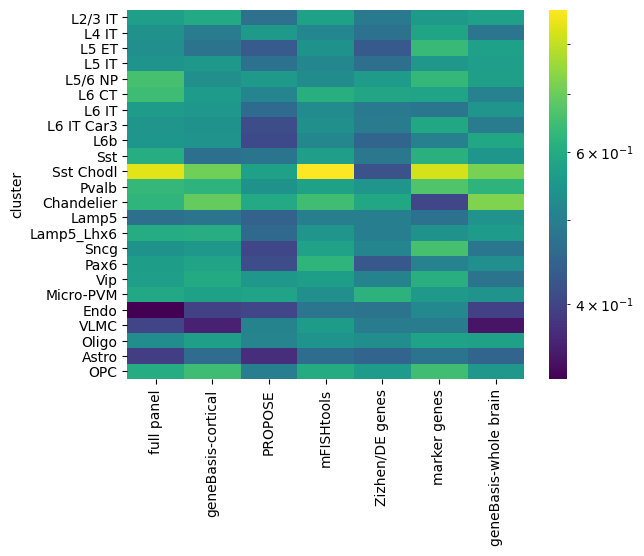

In [290]:
sns.heatmap(confusion, cmap='viridis', norm=LogNorm())

In [68]:
tg_vzg600_cl = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1666890074.598')
print(tg_vzg600.meta['training_genes'])
tg_gb_cl = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667414550.920')
print(tg_gb.meta['training_genes'])
tg_propose_cl = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667417895.311')
print(tg_propose.meta['training_genes'])
tg_mfishtools_cl = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667514967.374')
print(tg_mfishtools_cl.meta['training_genes'])
tg_zde_cl = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667421416.374')
print(tg_zde.meta['training_genes'])
tg_marker_cl = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667515701.735')
print(tg_marker.meta['training_genes'])
tg_wb_cl = TangramMapping.load_from_timestamp(directory=tg_mapping_path, timestamp='1667430432.836')
print(tg_wb.meta['training_genes'])

VZG600 panel
cortical geneBasis panel
cortical PROPOSE panel
mFISHtools panel
cortical Zizhen/DE genes panel
cortical marker genes panel
whole brain panel


In [69]:
panel_mappings_cluster = {
    'full panel': tg_vzg600_cl,
    'geneBasis-cortical': tg_gb_cl,
    'PROPOSE': tg_propose_cl,
    'mFISHtools': tg_mfishtools_cl,
    'Zizhen/DE genes': tg_zde_cl,
    'marker genes': tg_marker_cl,
    'geneBasis-whole brain': tg_wb_cl
}

In [ ]:
# for cluster level discrete mapping with 0.1 threshold

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


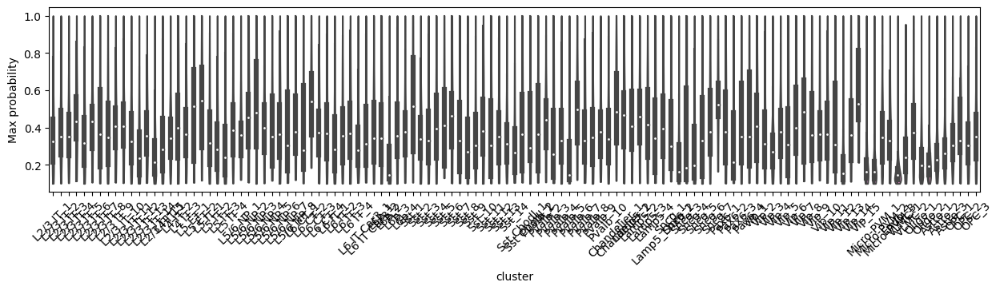

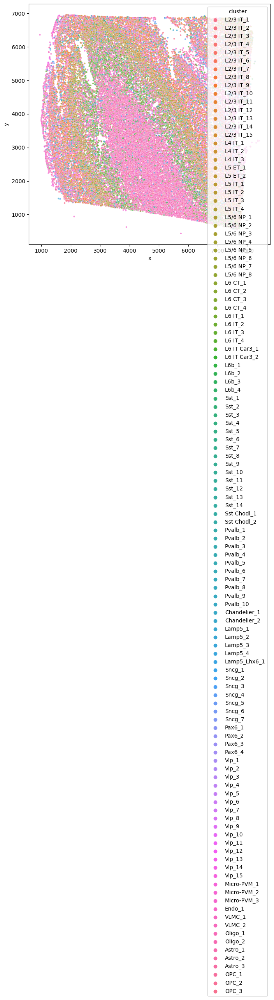

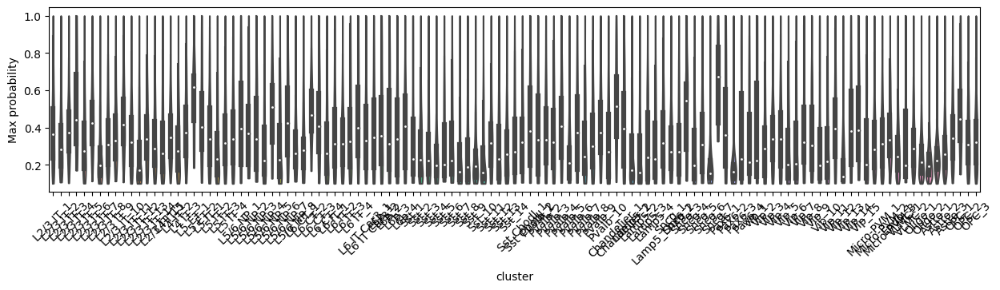

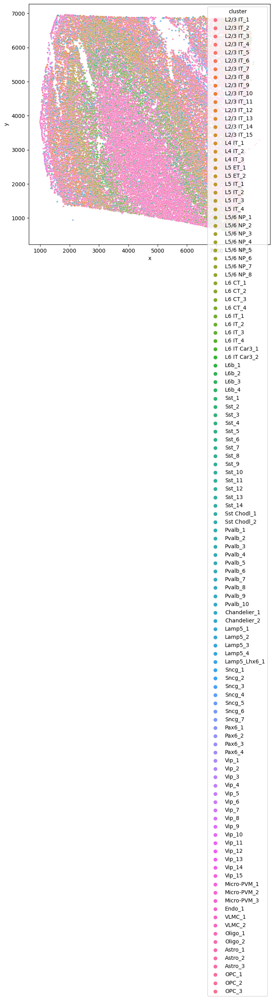

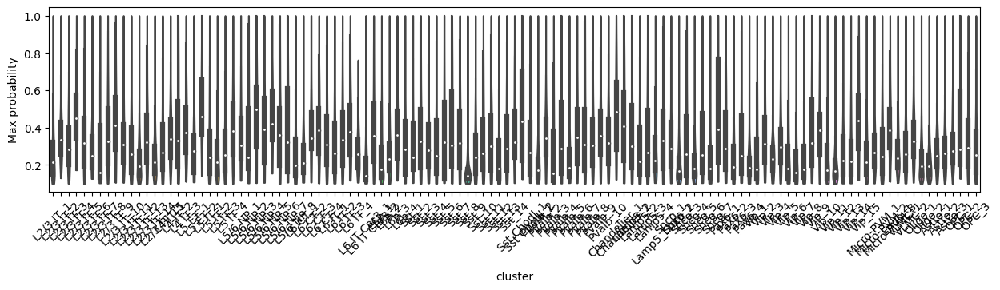

...

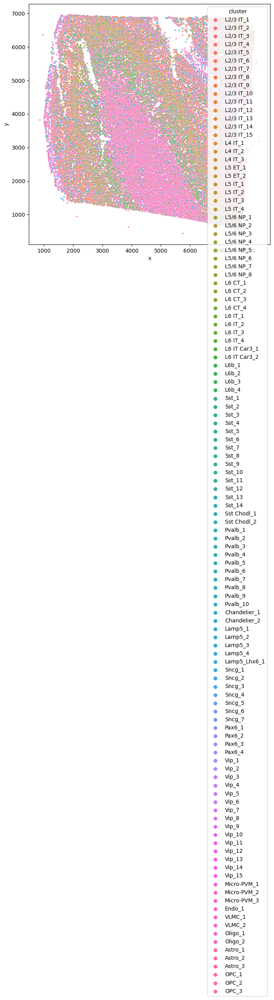

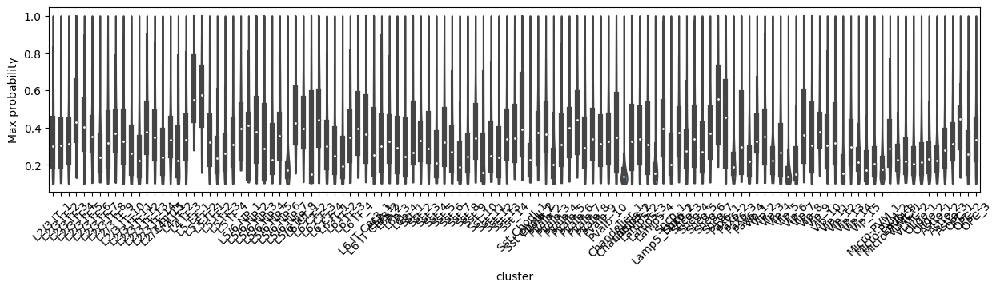

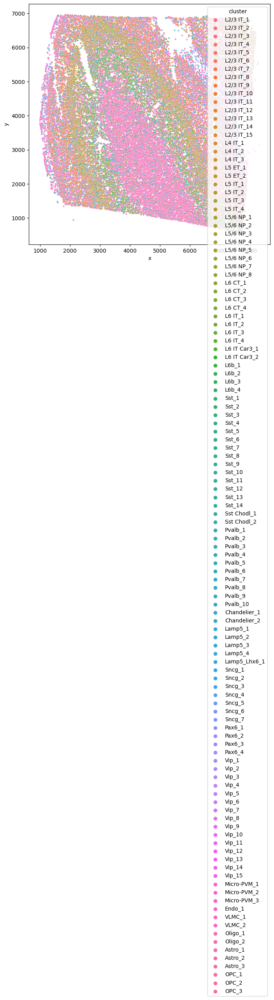

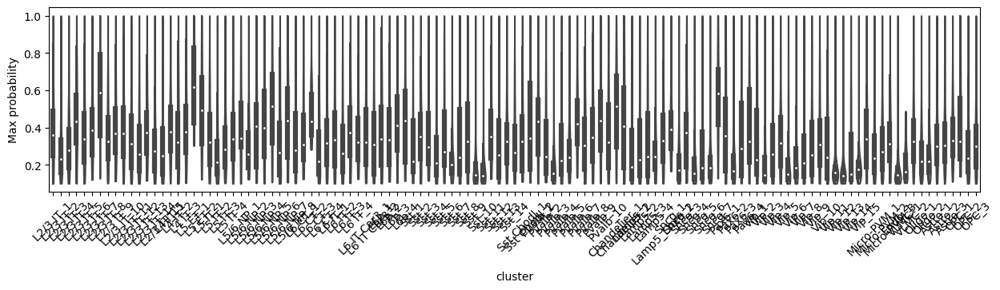

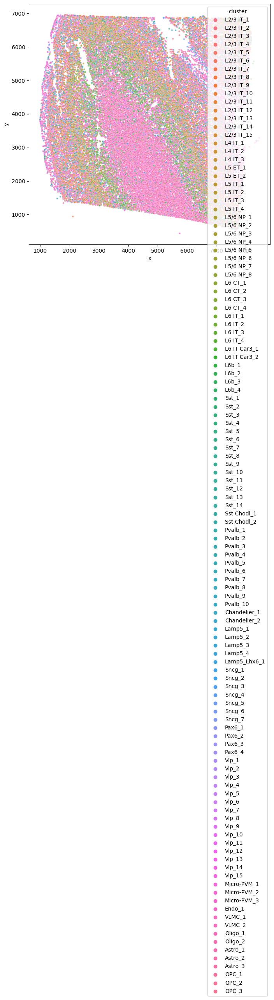

In [70]:
for mapping in panel_mappings_cluster.values():
    mapping.get_discrete_cell_mapping(threshold=0.1)
    mapping.plot_discrete_mapping()

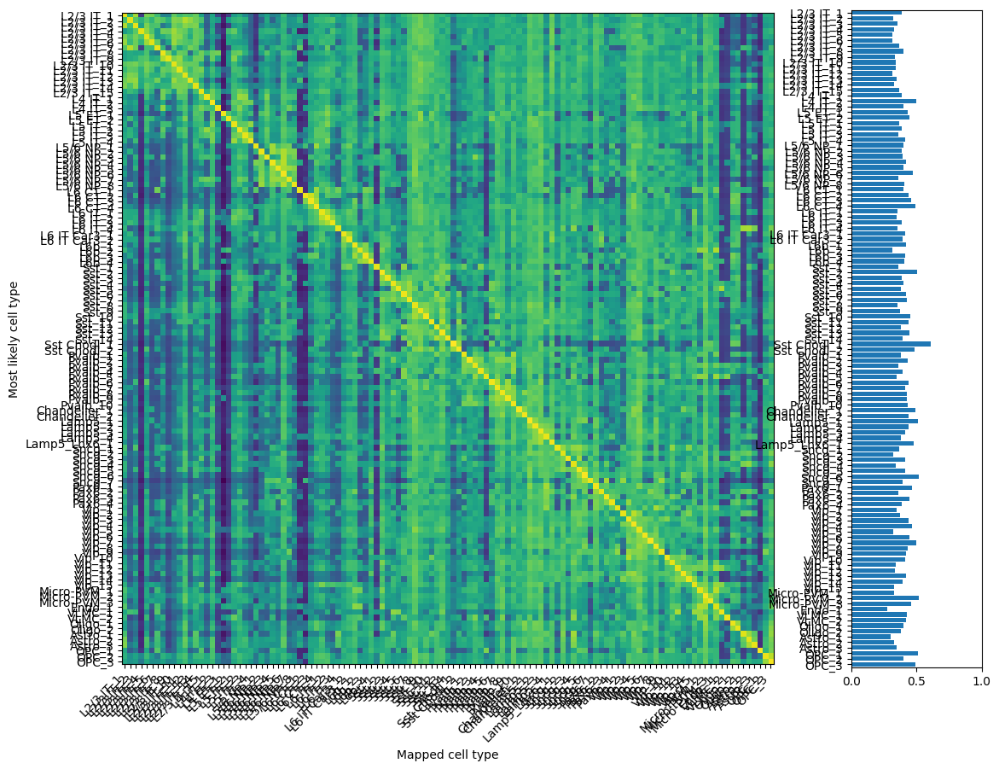

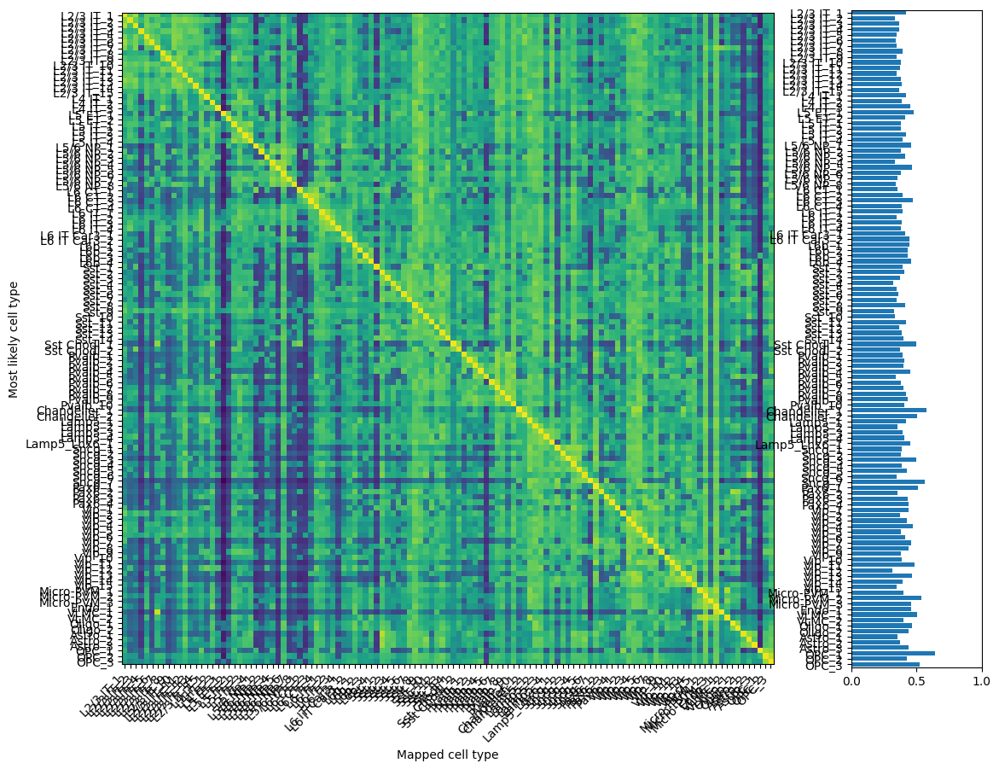

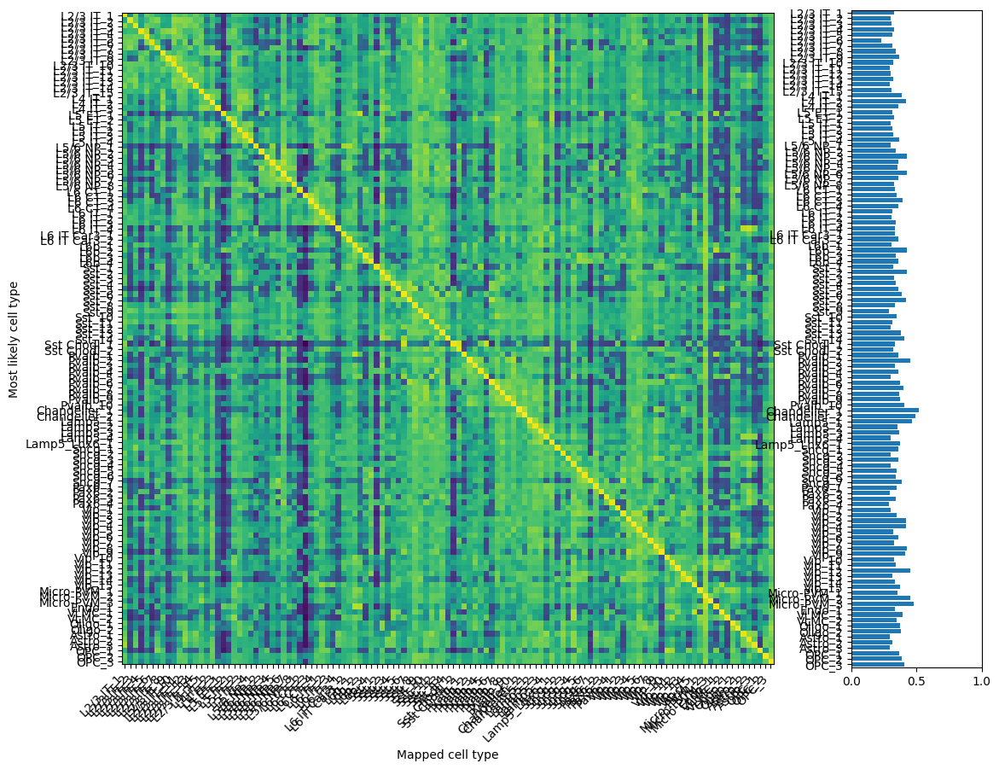

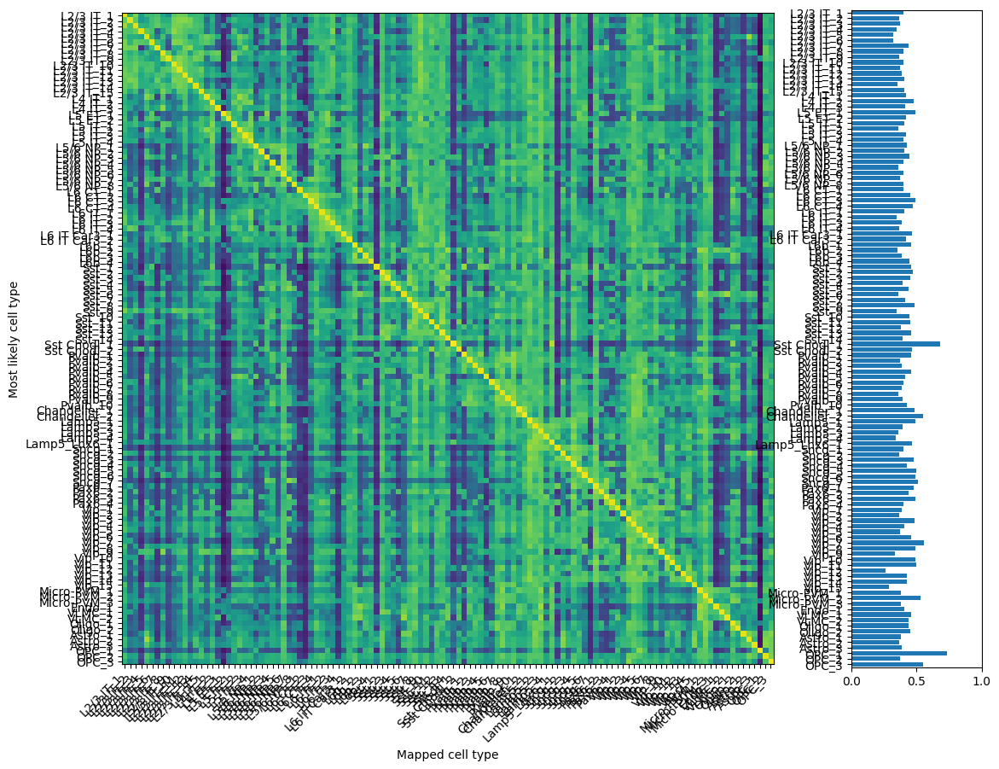

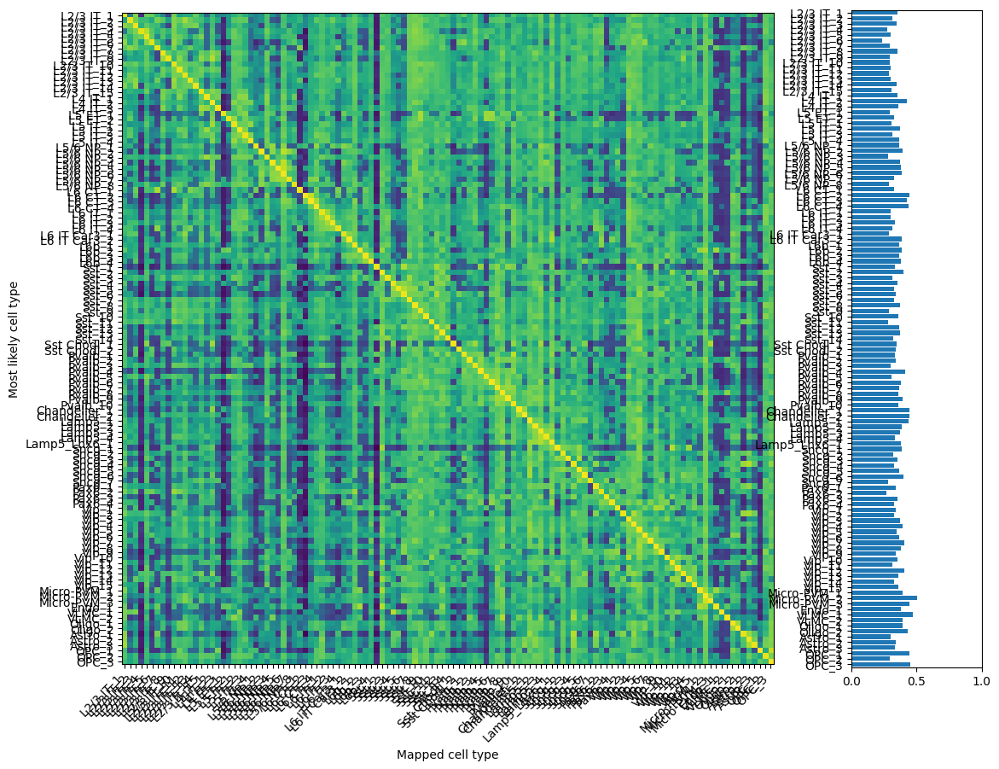

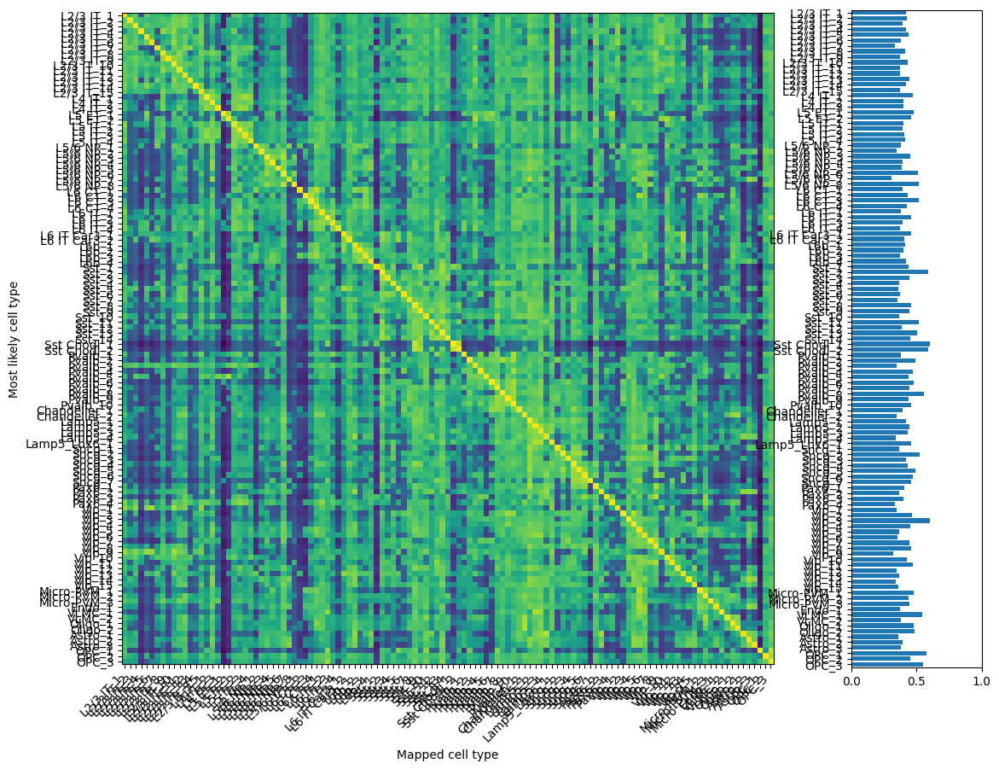

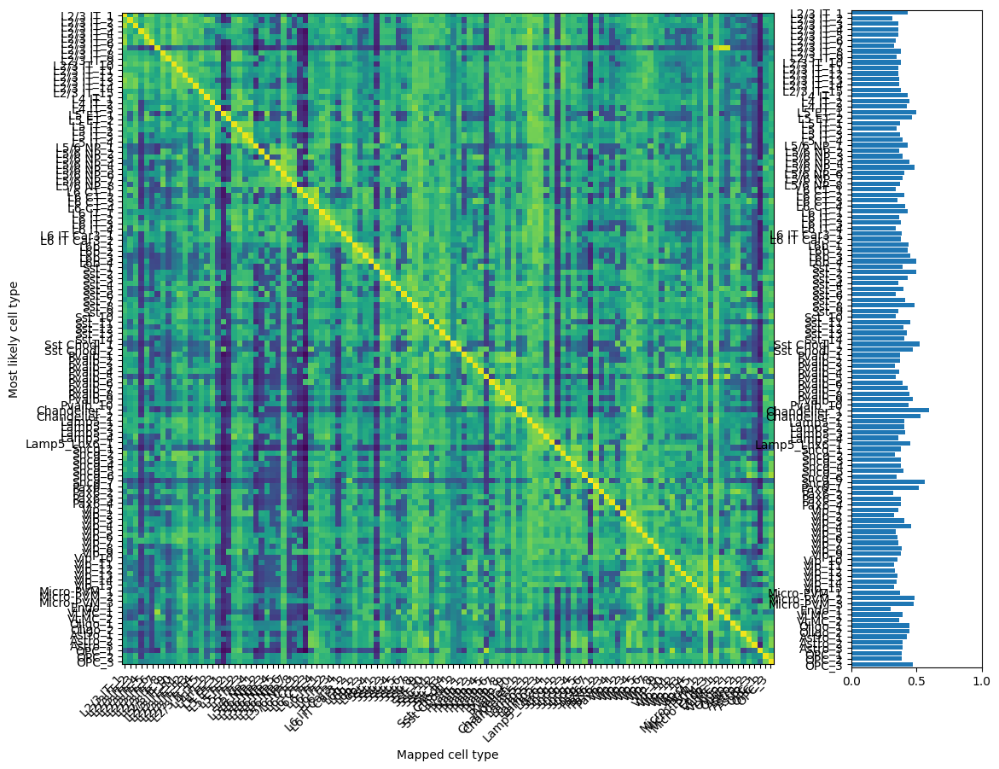

In [71]:
for mapping in panel_mappings_cluster.values():
    mapping.get_confusion_matrix()

In [330]:
all_panel_mapping_cluster = pd.DataFrame(tg_vzg600_cl.ad_sp.obs.index)
all_panel_mapping_cluster.set_index('cell', inplace=True)
all_panel_mapping_cluster

""
cell
1019095826100270249
1019095826100300124
1019095826100310136
1019095826100310139
1019095826100310140
...
1019095826202810044
1019095826202810050
1019095826202820029


In [331]:
for name, mapping in panel_mappings_cluster.items():
    prob_mapping = mapping.ad_sp.obsm['discrete_ct_pred'][['cluster_prop', 'cluster']]
    prob_mapping.rename(columns={'cluster_prop': name + '_prob', 'cluster': name + '_cluster'}, inplace=True)
    all_panel_mapping_cluster = all_panel_mapping_cluster.merge(prob_mapping, left_index=True, right_index=True)
    
all_panel_mapping_cluster.head()

,full panel_prob,full panel_cluster,geneBasis-cortical_prob,geneBasis-cortical_cluster,PROPOSE_prob,PROPOSE_cluster,mFISHtools_prob,mFISHtools_cluster,Zizhen/DE genes_prob,Zizhen/DE genes_cluster,marker genes_prob,marker genes_cluster,geneBasis-whole brain_prob,geneBasis-whole brain_cluster
cell,,,,,,,,,,,,,,
1019095826100270249,1.000000,Micro-PVM_3,NaN,NaN,0.295827,Micro-PVM_2,NaN,NaN,1.000000,Micro-PVM_3,NaN,NaN,NaN,NaN
1019095826100300124,0.202411,Micro-PVM_3,NaN,NaN,NaN,NaN,NaN,NaN,0.103845,Micro-PVM_3,NaN,NaN,0.210363,Micro-PVM_2
1019095826100310136,0.133543,Oligo_2,0.172708,Oligo_2,0.138346,Oligo_2,0.146930,Oligo_1,0.196409,Oligo_2,0.219282,Oligo_1,0.206595,Oligo_2
1019095826100310139,0.144517,Oligo_1,0.204119,Oligo_2,0.129398,Oligo_1,0.184438,Oligo_1,0.163543,Oligo_2,0.266645,Oligo_2,0.132967,Oligo_2
1019095826100310140,0.289354,Astro_1,0.111738,Vip_4,0.318715,Lamp5_4,0.271262,Astro_3,0.221873,Sst_11,0.276480,Lamp5_4,0.289019,Astro_3


In [332]:
cluster_cols = [c for c in all_panel_mapping_cluster.columns if c.endswith('_cluster')]
prob_cols = [c for c in all_panel_mapping_cluster.columns if c.endswith('_prob')]
all_panel_mapping_cluster['n_types'] = all_panel_mapping_cluster.apply(lambda x: len(x[cluster_cols].dropna().unique()), axis=1)
all_panel_mapping_cluster['avg_prob'] = all_panel_mapping_cluster.apply(lambda x: x[prob_cols].mean(), axis=1)
all_panel_mapping_cluster['cv_prob'] = all_panel_mapping_cluster.apply(lambda x: x[prob_cols].std() / x[prob_cols].mean(), axis=1)                                  
all_panel_mapping_cluster.head()

,full panel_prob,full panel_cluster,geneBasis-cortical_prob,geneBasis-cortical_cluster,PROPOSE_prob,PROPOSE_cluster,mFISHtools_prob,mFISHtools_cluster,Zizhen/DE genes_prob,Zizhen/DE genes_cluster,marker genes_prob,marker genes_cluster,geneBasis-whole brain_prob,geneBasis-whole brain_cluster,n_types,avg_prob,cv_prob
cell,,,,,,,,,,,,,,,,,
1019095826100270249,1.000000,Micro-PVM_3,NaN,NaN,0.295827,Micro-PVM_2,NaN,NaN,1.000000,Micro-PVM_3,NaN,NaN,NaN,NaN,2,0.765276,0.531252
1019095826100300124,0.202411,Micro-PVM_3,NaN,NaN,NaN,NaN,NaN,NaN,0.103845,Micro-PVM_3,NaN,NaN,0.210363,Micro-PVM_2,2,0.172206,0.344562
1019095826100310136,0.133543,Oligo_2,0.172708,Oligo_2,0.138346,Oligo_2,0.146930,Oligo_1,0.196409,Oligo_2,0.219282,Oligo_1,0.206595,Oligo_2,2,0.173402,0.200535
1019095826100310139,0.144517,Oligo_1,0.204119,Oligo_2,0.129398,Oligo_1,0.184438,Oligo_1,0.163543,Oligo_2,0.266645,Oligo_2,0.132967,Oligo_2,2,0.175089,0.278265
1019095826100310140,0.289354,Astro_1,0.111738,Vip_4,0.318715,Lamp5_4,0.271262,Astro_3,0.221873,Sst_11,0.276480,Lamp5_4,0.289019,Astro_3,5,0.254063,0.272404


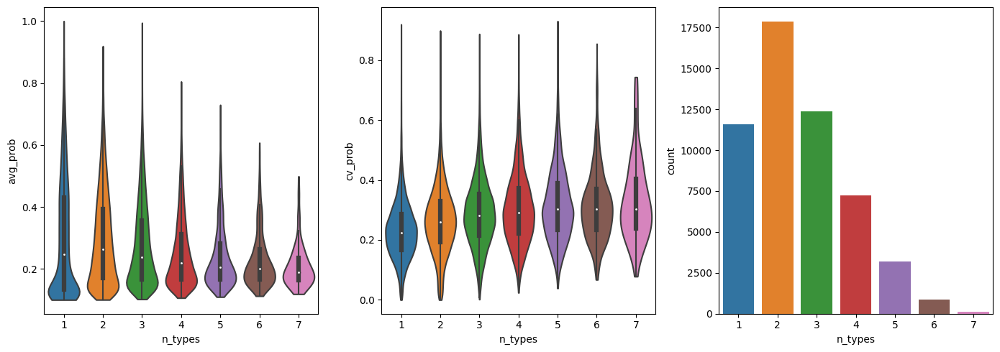

In [335]:
fig, ax = plt.subplots(1, 3, figsize=(14, 5))
sns.violinplot(data=all_panel_mapping_cluster[all_panel_mapping_cluster['n_types']>0], x='n_types', y='avg_prob', ax=ax[0], cut=0, scale='width')
sns.violinplot(data=all_panel_mapping_cluster[all_panel_mapping_cluster['n_types']>0], x='n_types', y='cv_prob', ax=ax[1], cut=0, scale='width')
sns.countplot(data=all_panel_mapping_cluster[all_panel_mapping_cluster['n_types']>0], x='n_types', ax=ax[2])
plt.tight_layout()

To Do:
- for cells that type to more than 1 cluster, are they all in the same subclass? DONE
- for cells that type to more than 1 cluster, is there a consistent pattern to which panels are different? ex. 3 panels are the same and 2 panels are consistently different (not quite sure how to go about this...)

In [338]:
two_three_types = all_panel_mapping_cluster[all_panel_mapping_cluster['n_types'].between(2, 3)]
two_three_types['subclasses'] = two_three_types.apply(lambda x: [x1.split('_')[0] for x1 in x[cluster_cols].dropna().unique()], axis=1)
two_three_types.head()

,full panel_prob,full panel_cluster,geneBasis-cortical_prob,geneBasis-cortical_cluster,PROPOSE_prob,PROPOSE_cluster,mFISHtools_prob,mFISHtools_cluster,Zizhen/DE genes_prob,Zizhen/DE genes_cluster,marker genes_prob,marker genes_cluster,geneBasis-whole brain_prob,geneBasis-whole brain_cluster,n_types,avg_prob,cv_prob,subclasses
cell,,,,,,,,,,,,,,,,,,
1019095826100270249,1.000000,Micro-PVM_3,NaN,NaN,0.295827,Micro-PVM_2,NaN,NaN,1.000000,Micro-PVM_3,NaN,NaN,NaN,NaN,2,0.765276,0.531252,"[Micro-PVM, Micro-PVM]"
1019095826100300124,0.202411,Micro-PVM_3,NaN,NaN,NaN,NaN,NaN,NaN,0.103845,Micro-PVM_3,NaN,NaN,0.210363,Micro-PVM_2,2,0.172206,0.344562,"[Micro-PVM, Micro-PVM]"
1019095826100310136,0.133543,Oligo_2,0.172708,Oligo_2,0.138346,Oligo_2,0.146930,Oligo_1,0.196409,Oligo_2,0.219282,Oligo_1,0.206595,Oligo_2,2,0.173402,0.200535,"[Oligo, Oligo]"
1019095826100310139,0.144517,Oligo_1,0.204119,Oligo_2,0.129398,Oligo_1,0.184438,Oligo_1,0.163543,Oligo_2,0.266645,Oligo_2,0.132967,Oligo_2,2,0.175089,0.278265,"[Oligo, Oligo]"
1019095826100310141,0.696710,VLMC_2,0.297180,VLMC_2,0.368279,VLMC_2,0.163645,VLMC_2,0.740936,VLMC_2,0.129584,Micro-PVM_2,0.418378,VLMC_2,2,0.402102,0.596473,"[VLMC, Micro-PVM]"


In [340]:
two_three_types['n_subclasses'] = two_three_types.apply(lambda x: len(set(x['subclasses'])), axis=1)
two_three_types.head()

,full panel_prob,full panel_cluster,geneBasis-cortical_prob,geneBasis-cortical_cluster,PROPOSE_prob,PROPOSE_cluster,mFISHtools_prob,mFISHtools_cluster,Zizhen/DE genes_prob,Zizhen/DE genes_cluster,marker genes_prob,marker genes_cluster,geneBasis-whole brain_prob,geneBasis-whole brain_cluster,n_types,avg_prob,cv_prob,subclasses,n_subclasses
cell,,,,,,,,,,,,,,,,,,,
1019095826100270249,1.000000,Micro-PVM_3,NaN,NaN,0.295827,Micro-PVM_2,NaN,NaN,1.000000,Micro-PVM_3,NaN,NaN,NaN,NaN,2,0.765276,0.531252,"[Micro-PVM, Micro-PVM]",1
1019095826100300124,0.202411,Micro-PVM_3,NaN,NaN,NaN,NaN,NaN,NaN,0.103845,Micro-PVM_3,NaN,NaN,0.210363,Micro-PVM_2,2,0.172206,0.344562,"[Micro-PVM, Micro-PVM]",1
1019095826100310136,0.133543,Oligo_2,0.172708,Oligo_2,0.138346,Oligo_2,0.146930,Oligo_1,0.196409,Oligo_2,0.219282,Oligo_1,0.206595,Oligo_2,2,0.173402,0.200535,"[Oligo, Oligo]",1
1019095826100310139,0.144517,Oligo_1,0.204119,Oligo_2,0.129398,Oligo_1,0.184438,Oligo_1,0.163543,Oligo_2,0.266645,Oligo_2,0.132967,Oligo_2,2,0.175089,0.278265,"[Oligo, Oligo]",1
1019095826100310141,0.696710,VLMC_2,0.297180,VLMC_2,0.368279,VLMC_2,0.163645,VLMC_2,0.740936,VLMC_2,0.129584,Micro-PVM_2,0.418378,VLMC_2,2,0.402102,0.596473,"[VLMC, Micro-PVM]",2


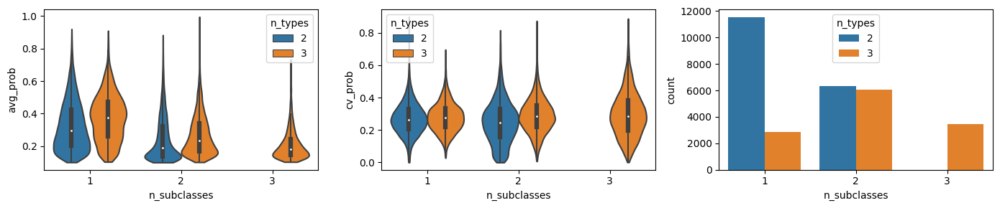

In [366]:
fig, ax = plt.subplots(1, 3, figsize=(14, 3))
sns.violinplot(data=two_three_types, x='n_subclasses', y='avg_prob', hue='n_types', split=False, ax=ax[0], cut=0, scale='width')
sns.violinplot(data=two_three_types, x='n_subclasses', y='cv_prob', hue='n_types', split=False, ax=ax[1], cut=0, scale='width')
sns.countplot(data=two_three_types, x='n_subclasses', hue='n_types', ax=ax[2])
plt.tight_layout()

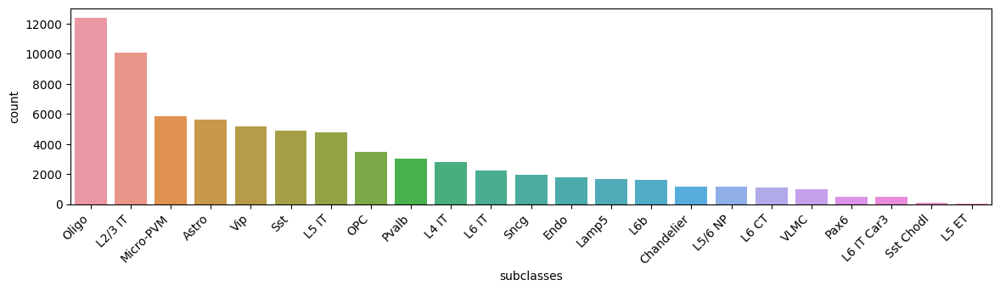

In [367]:
fig, ax = plt.subplots(figsize=(14, 3))
sns.countplot(two_three_types['subclasses'].explode(), order=two_three_types['subclasses'].explode().value_counts().index,
             ax=ax)
_ = ax.set_xticklabels(two_three_types['subclasses'].explode().value_counts().index, rotation=45, ha='right')

In [78]:
clusters = all_panel_mapping_cluster.melt(ignore_index=False, id_vars=prob_cols, var_name='panel', value_name='cluster')
clusters =  clusters.reset_index()
clusters = clusters[['cell', 'panel', 'cluster']]

cluster_prob = all_panel_mapping_cluster.melt(ignore_index=False, id_vars=cluster_cols, var_name='panel', value_name='cluster_prob')
cluster_prob = cluster_prob.reset_index()
cluster_prob = cluster_prob[['cell', 'panel', 'cluster_prob']]

clusters = clusters.merge(cluster_prob[['cell', 'panel', 'cluster_prob']], left_index=True, right_index=True)
clusters['panel'] = clusters.apply(lambda x: x['panel_y'].split('_')[0], axis=1)
clusters['cell'] = clusters.apply(lambda x: x['cell_y'] if x['cell_y']==x['cell_x'] else np.nan(), axis=1)
print(sum(clusters['cell'].isna()))

clusters = clusters[['cell', 'panel', 'cluster', 'cluster_prob']]
clusters.set_index('cell', inplace=True)
clusters.head()

0


,panel,cluster,cluster_prob
cell,,,
1019095826100270249,full panel,Micro-PVM_3,1.000000
1019095826100300124,full panel,Micro-PVM_3,0.202411
1019095826100310136,full panel,Oligo_2,0.133543
1019095826100310139,full panel,Oligo_1,0.144517
1019095826100310140,full panel,Astro_1,0.289354


In [92]:
labels = ordered_labels['cluster']
clusters['subclass'] = None
clusters['class'] = None
for name, group in {'exc': exc, 'inh': inh, 'glia': glia}.items():
    for group2 in group:
        group3 = [l for l in labels if l.startswith(group2)]
        clusters.loc[clusters['cluster'].isin(group3), 'subclass'] = group2
    clusters.loc[clusters['subclass'].isin(group), 'class'] = name

clusters.head()

,panel,cluster,cluster_prob,subclass,class
cell,,,,,
1019095826100270249,full panel,Micro-PVM_3,1.000000,Micro-PVM,glia
1019095826100300124,full panel,Micro-PVM_3,0.202411,Micro-PVM,glia
1019095826100310136,full panel,Oligo_2,0.133543,Oligo,glia
1019095826100310139,full panel,Oligo_1,0.144517,Oligo,glia
1019095826100310140,full panel,Astro_1,0.289354,Astro,glia


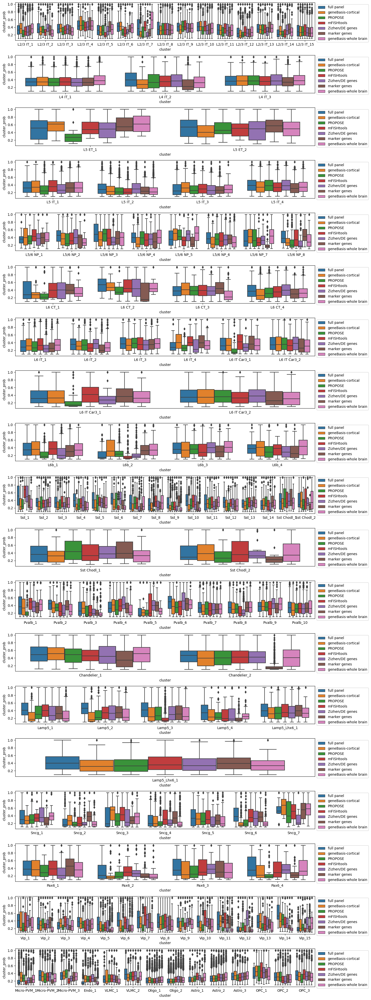

In [80]:
fig, ax = plt.subplots(19, 1, figsize=(15, 40))
ii = 0
for i, group in enumerate([exc, inh, glia]):
    group2 = [l for l in labels if l.startswith(group)]
    if i < 2:
        for subgroup in group:
            group3 = [l for l in labels if l.startswith(subgroup)]
            clusters[clusters['cluster'].isin(group3)['subclass'] = subgroup
            sns.boxplot(data=clusters[clusters['cluster'].isin(group3)], x='cluster', y='cluster_prob', hue='panel', ax=ax[ii], order=group3)
            ax[ii].legend(loc='upper left', bbox_to_anchor=(1, 1))
            ii+=1
    else:
        sns.boxplot(data=clusters[clusters['cluster'].isin(group2)], x='cluster', y='cluster_prob', hue='panel', ax=ax[ii], order=group2)
        ax[ii].legend(loc='upper left', bbox_to_anchor=(1, 1))
        ii+=1
        
plt.tight_layout()

In [293]:
clusters.groupby('panel').describe().sort_values(('cluster_prob',  'mean'), ascending=False)

cluster_prob                                          \
                             count      mean       std       min       25%   
panel                                                                        
full panel                 42739.0  0.321853  0.179211  0.100005  0.176995   
mFISHtools                 43982.0  0.316359  0.174989  0.100026  0.174563   
geneBasis-cortical         43700.0  0.313699  0.175544  0.100002  0.173399   
Zizhen/DE genes            45876.0  0.311197  0.172492  0.100000  0.174648   
geneBasis-whole brain      45313.0  0.307554  0.173757  0.100006  0.167705   
marker genes               41040.0  0.301767  0.172986  0.100004  0.165411   
PROPOSE                    45310.0  0.291994  0.166750  0.100008  0.163002   

                                                
                            50%       75%  max  
panel                                           
full panel             0.280549  0.427129  1.0  
mFISHtools             0.278585  0.416034  1.0  
geneBasis-cortical     0.271512  0.412927  1.0  
Zizhen/DE genes        0.270330  0.405373  1.0  
geneBasis-whole brain  0.264003  0.404221  1.0  
marker genes           0.257480  0.394192  1.0  
PROPOSE                0.246241  0.377368  1.0

In [305]:
clusters.groupby(['class', 'panel']).describe().sort_values(('cluster_prob',  'mean'), ascending=False)

cluster_prob                                \
                                   count      mean       std       min   
class panel                                                              
inh   full panel                  6679.0  0.371427  0.209977  0.100020   
exc   full panel                 16428.0  0.360608  0.186756  0.100007   
      geneBasis-cortical         15544.0  0.353565  0.188206  0.100002   
      geneBasis-whole brain      15357.0  0.353237  0.183894  0.100034   
      mFISHtools                 15846.0  0.349736  0.185538  0.100026   
      Zizhen/DE genes            15843.0  0.344112  0.183989  0.100026   
      marker genes               16533.0  0.335352  0.182787  0.100005   
inh   mFISHtools                  8112.0  0.333941  0.208547  0.100028   
exc   PROPOSE                    17466.0  0.317120  0.173800  0.100008   
inh   Zizhen/DE genes             9471.0  0.314057  0.201269  0.100032   
      geneBasis-cortical          8680.0  0.312995  0.201373  0.100009   
      PROPOSE                    11286.0  0.294446  0.189493  0.100025   
      marker genes                9771.0  0.293556  0.192788  0.100004   
      geneBasis-whole brain      11086.0  0.289081  0.193743  0.100006   
glia  Zizhen/DE genes            20562.0  0.284519  0.141755  0.100000   
      mFISHtools                 20024.0  0.282822  0.142370  0.100035   
      geneBasis-cortical         19476.0  0.282197  0.143329  0.100020   
      geneBasis-whole brain      18870.0  0.281229  0.142608  0.100021   
      full panel                 19632.0  0.272558  0.145646  0.100005   
      marker genes               14736.0  0.269531  0.137348  0.100038   
      PROPOSE                    16558.0  0.263817  0.135241  0.100060   

                                                                
                                  25%       50%       75%  max  
class panel                                                     
inh   full panel             0.193949  0.335694  0.503957  1.0  
exc   full panel             0.207668  0.333992  0.478907  1.0  
      geneBasis-cortical     0.198667  0.320228  0.471768  1.0  
      geneBasis-whole brain  0.204014  0.322769  0.466826  1.0  
      mFISHtools             0.197369  0.316734  0.463619  1.0  
      Zizhen/DE genes        0.194283  0.309089  0.454464  1.0  
      marker genes           0.186591  0.298041  0.441220  1.0  
inh   mFISHtools             0.154536  0.281023  0.463117  1.0  
exc   PROPOSE                0.179131  0.277435  0.416510  1.0  
inh   Zizhen/DE genes        0.149082  0.250580  0.429689  1.0  
      geneBasis-cortical     0.144849  0.251797  0.432205  1.0  
      PROPOSE                0.147267  0.230742  0.389259  1.0  
      marker genes           0.141958  0.226765  0.395438  1.0  
      geneBasis-whole brain  0.139928  0.212309  0.393293  1.0  
glia  Zizhen/DE genes        0.174825  0.253480  0.362214  1.0  
      mFISHtools             0.169024  0.253745  0.364668  1.0  
      geneBasis-cortical     0.171800  0.248972  0.358692  1.0  
      geneBasis-whole brain  0.169438  0.248691  0.360627  1.0  
      full panel             0.159054  0.234304  0.348014  1.0  
      marker genes           0.165174  0.236266  0.338355  1.0  
      PROPOSE                0.161089  0.230228  0.330668  1.0

In [254]:
cluster_median = clusters.groupby(['cluster', 'panel']).median().unstack().loc(axis=0)[ordered_labels['cluster']]
cluster_median.columns = cluster_median.columns.droplevel(None)
cluster_median = cluster_median[list(panel_mappings_cluster.keys())]
cluster_median

panel,full panel,geneBasis-cortical,PROPOSE,mFISHtools,Zizhen/DE genes,marker genes,geneBasis-whole brain
cluster,,,,,,,
L2/3 IT_1,0.326644,0.366307,0.212732,0.288185,0.276052,0.300300,0.359764
L2/3 IT_2,0.352055,0.283512,0.334546,0.259048,0.377824,0.304488,0.230324
L2/3 IT_3,0.352679,0.373325,0.281583,0.320331,0.354082,0.312395,0.276673
L2/3 IT_4,0.430986,0.442875,0.451332,0.398118,0.402421,0.429755,0.432467
L2/3 IT_5,0.316408,0.273027,0.316416,0.182734,0.290690,0.403250,0.337646
...,...,...,...,...,...,...,...
Astro_2,0.261061,0.255719,0.262682,0.302308,0.279850,0.276563,0.303497
Astro_3,0.305119,0.342035,0.276240,0.286305,0.305470,0.314128,0.331117
OPC_1,0.329982,0.447342,0.280848,0.461753,0.415597,0.445929,0.327702


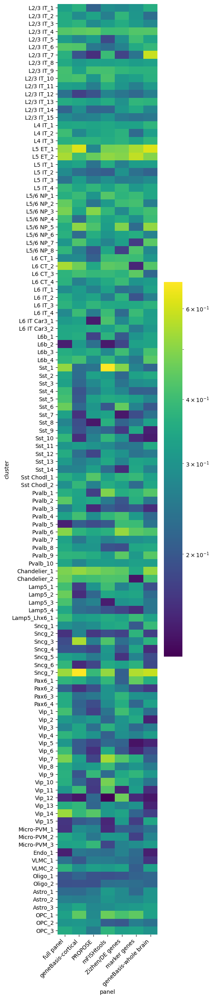

In [263]:
fig, ax = plt.subplots(figsize=(4, 30))
sns.heatmap(cluster_median, cmap='viridis', norm=LogNorm(), ax=ax)
_ = ax.set_xticklabels(cluster_median.columns, rotation=45, ha='right')

(0.0, 1.0)

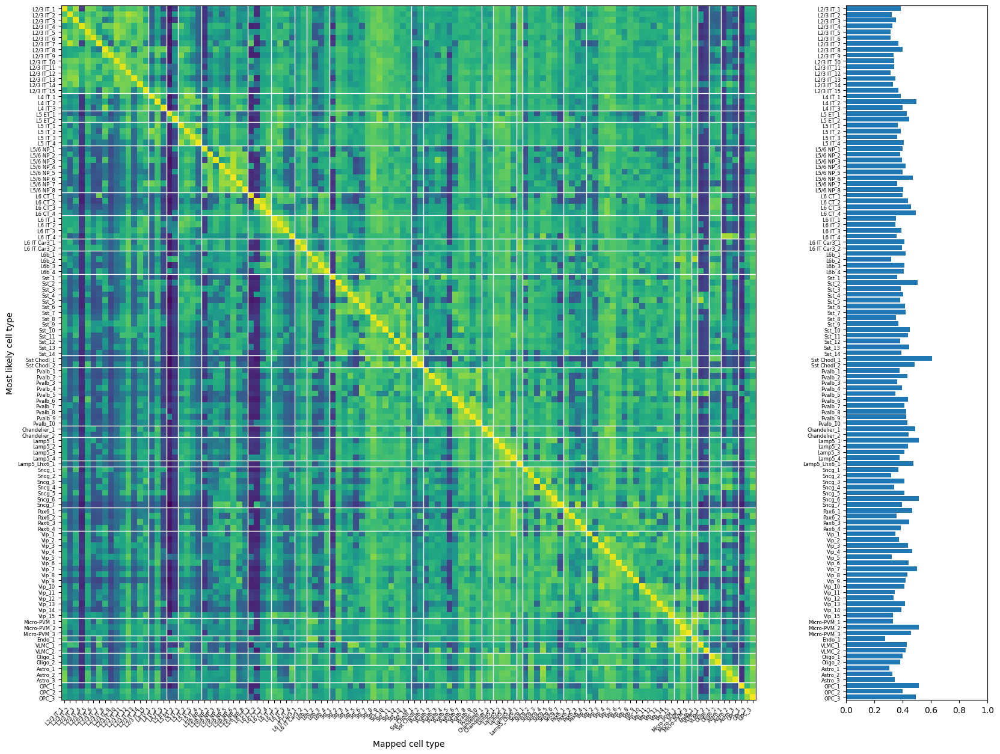

In [387]:
fig, ax = plt.subplots(figsize=(20, 15))

gs = plt.GridSpec(1, 2, width_ratios=[5,1])
ax1 = plt.subplot(gs[0])
ax2 = plt.subplot(gs[1], sharey=ax1)

ax1.imshow(np.log(tg_vzg600_cl.confusion_matrix))
ax1.set_yticks(np.arange(len(list(ordered_labels['cluster'].keys()))))
ax1.set_yticklabels(list(ordered_labels['cluster'].keys()), fontsize=6)
ax1.set_xticks(np.arange(len(list(ordered_labels['cluster'].keys()))))
ax1.set_xticklabels(list(ordered_labels['cluster'].keys()), fontsize=6, rotation=45, ha='right')
ax1.set_ylabel('Most likely cell type')
ax1.set_xlabel('Mapped cell type')

lines = [14.5, 17.5, 19.5, 23.5, 31.5, 35.5, 39.5, 41.5, 45.5, 59.5, 61.5, 71.5, 73.5, 77.5, 78.5, 85.5, 89.5, 104.5, 107.5, 108.5, 110.5, 112.5, 115.5]
[ax1.axhline(l, color='w', lw=1) for l in lines]
[ax1.axvline(l, color='w', lw=1) for l in lines]

diff = np.diag(tg_vzg600_cl.confusion_matrix) / tg_vzg600_cl.confusion_matrix.sum(axis=1)

ax2.barh(np.arange(len(list(ordered_labels['cluster'].keys()))), diff)
ax2.set_yticks(np.arange(len(list(ordered_labels['cluster'].keys()))))
ax2.set_yticklabels(list(ordered_labels['cluster'].keys()), fontsize=6)
ax2.set_xlim(0, 1)

In [415]:
confusion_cluster = pd.DataFrame(index=ordered_labels['cluster'].keys())

for name, mapping in panel_mappings_cluster.items():
    diff = np.diag(mapping.confusion_matrix) / mapping.confusion_matrix.sum(axis=1)
    confusion_cluster[name] = diff
confusion_cluster.index.name = 'cluster'
confusion_cluster

,full panel,geneBasis-cortical,PROPOSE,mFISHtools,Zizhen/DE genes,marker genes,geneBasis-whole brain
cluster,,,,,,,
L2/3 IT_1,0.384335,0.419089,0.327963,0.399792,0.352439,0.416040,0.433608
L2/3 IT_2,0.322446,0.333931,0.300885,0.363679,0.316281,0.421749,0.310854
L2/3 IT_3,0.350981,0.367761,0.307537,0.371005,0.349275,0.393202,0.357775
L2/3 IT_4,0.324432,0.365040,0.325715,0.349247,0.275196,0.419658,0.358239
L2/3 IT_5,0.312719,0.347746,0.315068,0.322534,0.302674,0.438137,0.361939
...,...,...,...,...,...,...,...
Astro_2,0.326354,0.372947,0.311084,0.369028,0.337931,0.394488,0.390252
Astro_3,0.344117,0.434879,0.295799,0.383548,0.331883,0.377939,0.393556
OPC_1,0.513109,0.642171,0.367578,0.732057,0.444052,0.578297,0.388376


In [281]:
confusion_cluster.describe().T.sort_values('mean', ascending=False)

,count,mean,std,min,25%,50%,75%,max
marker genes,119.0,0.425386,0.062691,0.309831,0.375798,0.419658,0.458849,0.604916
mFISHtools,119.0,0.421465,0.065581,0.262029,0.379445,0.407485,0.458394,0.732057
geneBasis-cortical,119.0,0.407404,0.056230,0.315079,0.372668,0.394708,0.435411,0.642171
full panel,119.0,0.399562,0.056332,0.273235,0.357745,0.396518,0.433990,0.605849
geneBasis-whole brain,119.0,0.397888,0.054935,0.301186,0.358591,0.386590,0.430326,0.594120
Zizhen/DE genes,119.0,0.353232,0.048274,0.236806,0.316991,0.352439,0.380015,0.505360
PROPOSE,119.0,0.352427,0.048447,0.226031,0.316526,0.343579,0.371468,0.518511


In [426]:
labels = ordered_labels['cluster']
confusion_cluster['subclass'] = None
confusion_cluster['class'] = None
for name, group in {'exc': exc, 'inh': inh, 'glia': glia}.items():
    for group2 in group:
        group3 = [l for l in labels if l.startswith(group2)]
        confusion_cluster.loc[group3, 'subclass'] = group2
    confusion_cluster.loc[confusion_cluster['subclass'].isin(group), 'class'] = name

confusion_cluster.head()

,full panel,geneBasis-cortical,PROPOSE,mFISHtools,Zizhen/DE genes,marker genes,geneBasis-whole brain,subclass,class
cluster,,,,,,,,,
L2/3 IT_1,0.384335,0.419089,0.327963,0.399792,0.352439,0.416040,0.433608,L2/3 IT,exc
L2/3 IT_2,0.322446,0.333931,0.300885,0.363679,0.316281,0.421749,0.310854,L2/3 IT,exc
L2/3 IT_3,0.350981,0.367761,0.307537,0.371005,0.349275,0.393202,0.357775,L2/3 IT,exc
L2/3 IT_4,0.324432,0.365040,0.325715,0.349247,0.275196,0.419658,0.358239,L2/3 IT,exc
L2/3 IT_5,0.312719,0.347746,0.315068,0.322534,0.302674,0.438137,0.361939,L2/3 IT,exc


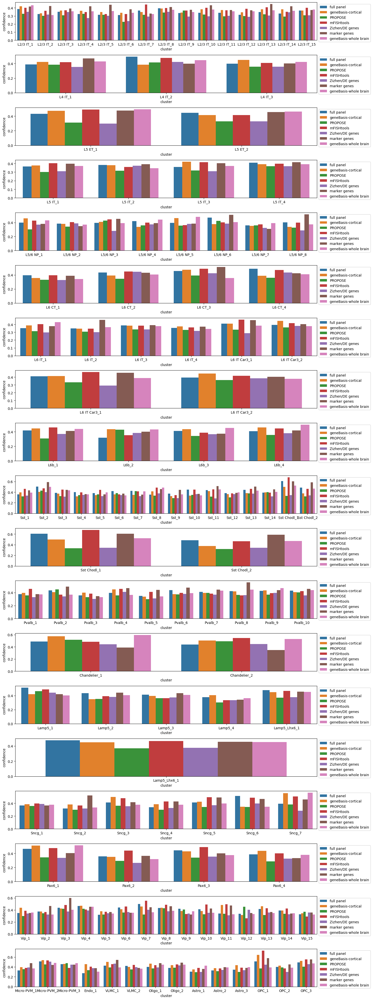

In [407]:
fig, ax = plt.subplots(19, 1, figsize=(15, 40))
ii = 0
for i, group in enumerate([exc, inh, glia]):
    group2 = [l for l in labels if l.startswith(group)]
    if i < 2:
        for subgroup in group:
            group3 = [l for l in labels if l.startswith(subgroup)]
            data = confusion_cluster.loc(axis=0)[group3].melt(ignore_index=False, var_name='panel', value_name='confidence').reset_index(names='cluster')
            sns.barplot(data=data, x='cluster', y='confidence', hue='panel', ax=ax[ii], order=group3)
            ax[ii].legend(loc='upper left', bbox_to_anchor=(1, 1))
            ii+=1
    else:
        data = confusion_cluster.loc(axis=0)[group2].melt(ignore_index=False, var_name='panel', value_name='confidence').reset_index(names='cluster')
        sns.barplot(data=data, x='cluster', y='confidence', hue='panel', ax=ax[ii], order=group2)
        ax[ii].legend(loc='upper left', bbox_to_anchor=(1, 1))
        ii+=1
        
plt.tight_layout()

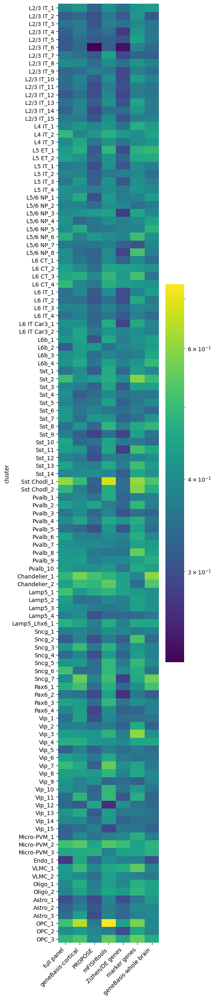

In [421]:
fig, ax = plt.subplots(figsize=(4, 30))
sns.heatmap(confusion_cluster, cmap='viridis', norm=LogNorm(), ax=ax)
_ = ax.set_xticklabels(confusion_cluster.columns, rotation=45, ha='right')

<AxesSubplot: ylabel='count'>

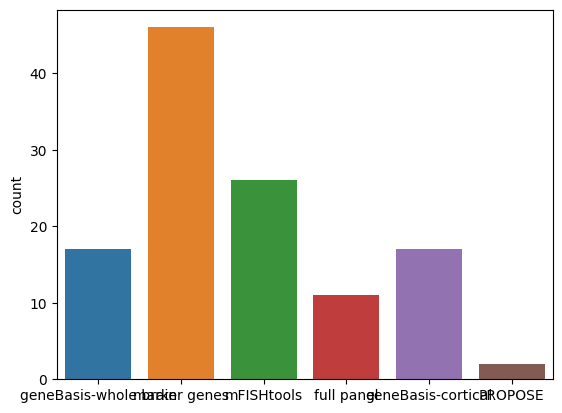

In [418]:
confusion_winner = confusion_cluster.idxmax(axis=1)
sns.countplot(confusion_winner)

"Spatial coherence" via K-nearest neighbors calculation

In [538]:
knn_subclass = {}

for name, mapping in panel_mappings_subclass.items():
    discrete_map = mapping.ad_sp.obsm['discrete_ct_pred']
    knn_subclass[name] = {}
    for group in discrete_map['cluster'].unique():
        X = discrete_map[discrete_map['cluster']==group][['x', 'y']].to_numpy()
        nbrs = NearestNeighbors(n_neighbors=10, algorithm='ball_tree').fit(X)
        distances, indices = nbrs.kneighbors(X)
        knn_subclass[name][group] = distances[:,1:].mean() * np.sqrt(len(X))

knn_subclass_df = pd.DataFrame(knn_subclass)
knn_subclass_df

,full panel,geneBasis-cortical,PROPOSE,mFISHtools,Zizhen/DE genes,marker genes,geneBasis-whole brain
Micro-PVM,7216.800461,7284.859636,7263.516054,7148.576147,7289.603455,7089.007349,7243.876896
Oligo,5528.139792,5373.899238,5497.117230,4886.536922,5860.353457,5276.739381,5700.376910
Astro,7352.153775,7363.268780,6671.539623,7391.468408,7358.866179,7385.973476,7333.702011
VLMC,7202.750079,6517.739303,7312.212090,7229.683509,7330.373817,6375.788006,6513.948969
OPC,7359.094520,7412.799781,7293.388766,7406.767652,7404.233158,7329.290745,7417.530405
Endo,6813.727299,7085.227828,6688.309387,7361.445518,7102.459498,7376.080908,6649.108825
Vip,7277.267898,7326.875374,7172.972072,7343.405244,7302.579671,6833.392257,7266.545827
Lamp5,7455.677445,7316.933394,7331.562283,7371.598758,7387.195025,7437.840870,7303.270509
Sst,7108.363719,7298.487810,7118.202431,7173.981157,7308.661138,7337.850182,7354.596166
L6 CT,4277.796809,5542.232827,5252.178259,4359.821538,4809.127780,6030.932865,6495.033319


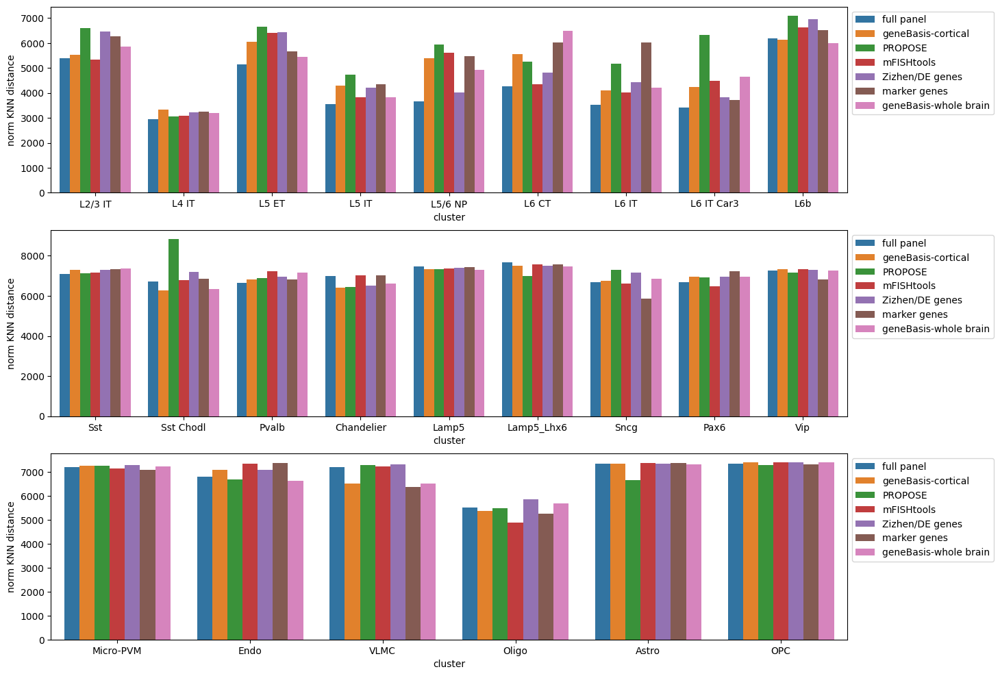

In [540]:
fig, ax = plt.subplots(3, 1, figsize=(15, 12))
for i, group in enumerate([exc, inh, glia]):
    data = knn_subclass_df.loc(axis=0)[group].melt(ignore_index=False, var_name='panel', value_name='norm KNN distance').reset_index(names='cluster')
    sns.barplot(data=data, x='cluster', y='norm KNN distance', hue='panel', ax=ax[i], order=group)
    ax[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
#     ax[i].set_yscale('log')

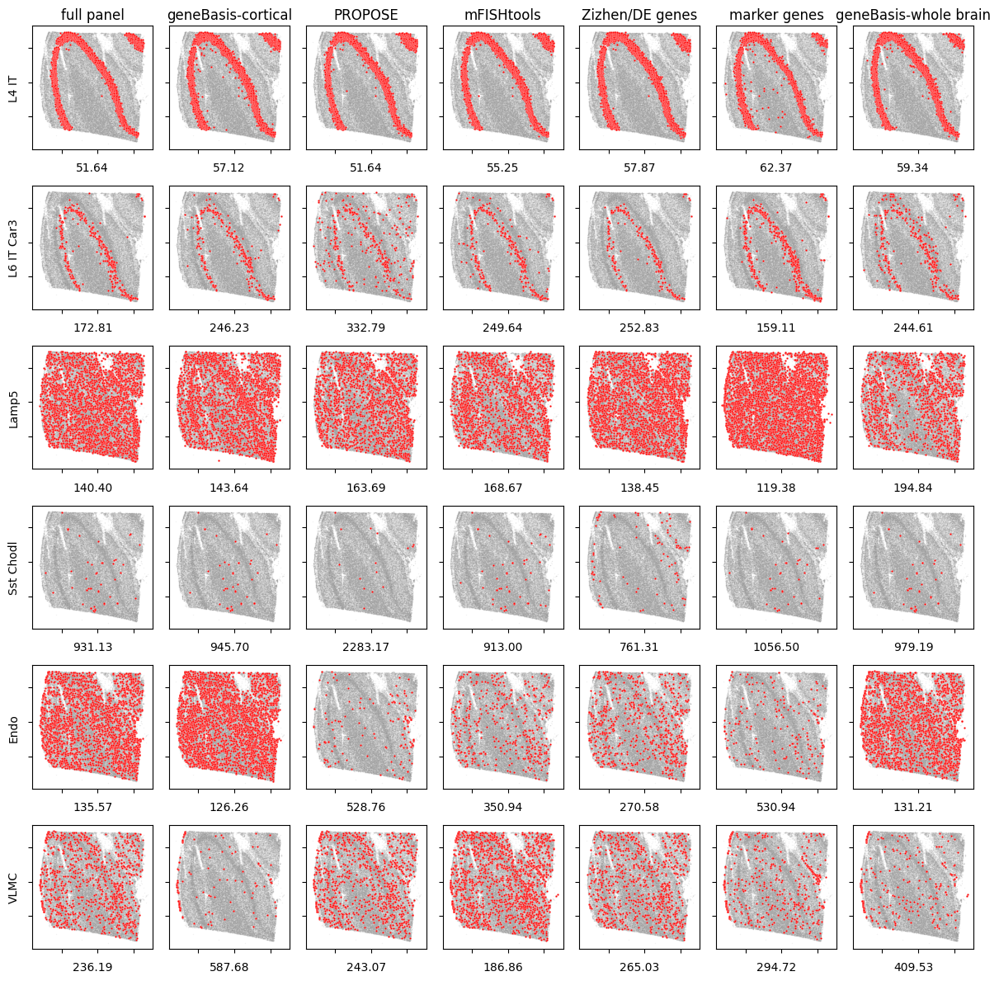

In [443]:
groups = ['L4 IT', 'L6 IT Car3', 'Lamp5', 'Sst Chodl', 'Endo', 'VLMC']
    
fig, ax = plt.subplots(len(groups), 7, figsize=(12, 2*len(groups)))

for i, group in enumerate(groups):
    for j, (name, mapping) in enumerate(panel_mappings_subclass.items()):
        discrete_map = mapping.ad_sp.obsm['discrete_ct_pred']
        sns.scatterplot(data=discrete_map, x='x', y='y', s=1, color='grey', alpha=0.1, ax=ax[i,j])
        discrete_map = discrete_map[discrete_map['cluster']==group]
        sns.scatterplot(data=discrete_map, x='x', y='y', s=3, color='red', ax=ax[i,j])
        ax[i, j].set_xticklabels([])
        ax[i, j].set_yticklabels([])
        ax[i, j].set_ylabel('')
        ax[0, j].set_title(name)
        knn = knn_subclass_df.loc[group][name]
        ax[i, j].set_xlabel(f'{knn:0.2f}')
    ax[i, 0].set_ylabel(group)

plt.tight_layout()

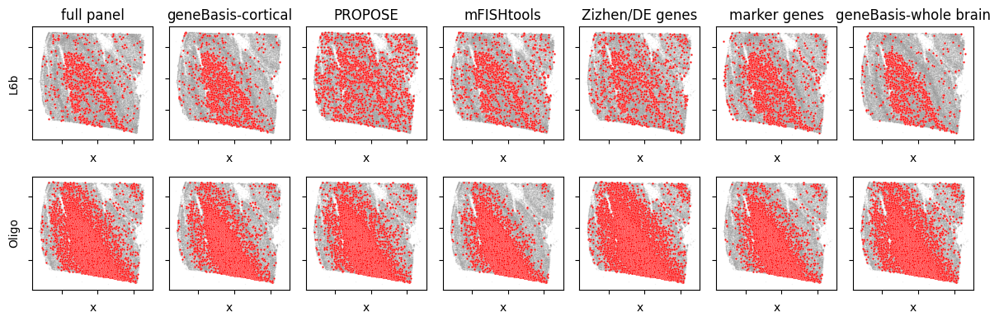

In [444]:
groups = ['L6b', 'Oligo']
    
fig, ax = plt.subplots(len(groups), 7, figsize=(12, 2*len(groups)))

for i, group in enumerate(groups):
    for j, (name, mapping) in enumerate(panel_mappings_subclass.items()):
        discrete_map = mapping.ad_sp.obsm['discrete_ct_pred']
        sns.scatterplot(data=discrete_map, x='x', y='y', s=1, color='grey', alpha=0.1, ax=ax[i,j])
        discrete_map = discrete_map[discrete_map['cluster']==group]
        sns.scatterplot(data=discrete_map, x='x', y='y', s=3, color='red', ax=ax[i,j])
        ax[i, j].set_xticklabels([])
        ax[i, j].set_yticklabels([])
        ax[i, j].set_ylabel('')
        ax[0, j].set_title(name)
        knn = knn_subclass_df.loc[group][name]
#         ax[i, j].set_xlabel(f'{knn:0.2f}')
    ax[i, 0].set_ylabel(group)

plt.tight_layout()

In [301]:
knn_subclass_df.describe().T.sort_values('mean', ascending=False)

,count,mean,std,min,25%,50%,75%,max
PROPOSE,24.0,294.857485,453.826640,51.635975,115.700808,165.378611,293.695248,2283.170599
geneBasis,24.0,245.751563,238.748279,57.121603,103.024809,147.301308,278.478187,945.698541
mFISHtools,24.0,240.909697,232.713444,51.189311,100.344322,163.238002,277.720173,897.212582
marker genes,24.0,237.041604,239.605215,60.877800,117.670504,150.416250,221.410427,1056.501577
whole brain,24.0,232.769319,218.486590,59.340765,102.291743,163.529489,269.348232,979.188898
Zizhen/DE genes,24.0,228.514000,190.906906,57.490375,108.740191,152.669039,276.241617,761.306470
vzg600,24.0,216.494048,206.382644,51.640424,106.832930,140.544767,237.329840,931.131232


In [541]:
knn_cluster = {}

for name, mapping in panel_mappings_cluster.items():
    discrete_map = mapping.ad_sp.obsm['discrete_ct_pred'].dropna()
    knn_cluster[name] = {}
    for group in discrete_map['cluster'].unique():
        X = discrete_map[discrete_map['cluster']==group][['x', 'y']].to_numpy()
        if len(X) == 0:
            print(f'No samples for {group}')
            continue
        k = 10 if len(X) > 10 else len(X)
        nbrs = NearestNeighbors(n_neighbors=k, algorithm='ball_tree').fit(X)
        distances, indices = nbrs.kneighbors(X)
        knn_cluster[name][group] = distances[:,1:].mean() * np.sqrt(len(X))

knn_cluster_df = pd.DataFrame(knn_cluster)
knn_cluster_df = knn_cluster_df.loc[list(ordered_labels['cluster'])]
knn_cluster_df.head()

,full panel,geneBasis-cortical,PROPOSE,mFISHtools,Zizhen/DE genes,marker genes,geneBasis-whole brain
L2/3 IT_1,2394.642725,3222.541556,5459.917824,3491.439530,4197.588052,5371.431850,3116.802772
L2/3 IT_2,4690.046027,5434.717700,5067.280501,5175.799615,5079.240026,4855.397850,5837.890228
L2/3 IT_3,3305.612332,3824.476384,4642.310707,4151.937781,4273.518780,4303.352278,5144.460349
L2/3 IT_4,6367.575053,6852.531982,6152.578812,6327.863729,6880.216599,6718.527697,5644.405755
L2/3 IT_5,3276.819447,4743.437295,3787.447654,6499.854987,3522.900310,4056.509230,3517.135416


In [542]:
knn_cluster_df.describe().T.sort_values('mean', ascending=False)

,count,mean,std,min,25%,50%,75%,max
PROPOSE,119.0,6359.363535,1521.832069,2410.491340,5168.424941,6725.518374,7396.674513,9356.900563
Zizhen/DE genes,119.0,6258.518930,1677.450113,2379.041965,5095.930158,6540.207550,7343.133111,10320.258449
geneBasis-cortical,119.0,6168.478712,1636.758012,2386.103004,5239.433772,6428.053654,7347.767511,10453.686530
geneBasis-whole brain,119.0,6119.640118,1672.346813,2497.995486,4835.175143,6466.705617,7387.414405,10844.051328
marker genes,119.0,6035.750789,1562.827888,2330.322852,4805.131355,6293.925367,7307.703055,9252.143872
mFISHtools,119.0,5995.568279,1659.974451,2366.825111,4895.866513,6392.321354,7307.804619,9314.516706
full panel,119.0,5752.852681,1835.163327,2319.527496,4165.635969,5926.485786,7121.381204,10244.031430


In [549]:
def get_max_diff(row, return_val='panel'):
    diff_dict = {}
    cols = list(panel_mappings_cluster.keys())
    for panel in cols:
        median = row[cols].median()
        median_diff = row[panel] - median
        perc_diff = (median_diff - median) / median *100
        diff_dict[perc_diff] = panel
    max_diff = max(diff_dict.keys())
    max_panel = diff_dict[max_diff]
    if return_val == 'panel':
        return max_panel
    if return_val == 'diff':
        return abs(max_diff)
    
knn_cluster_df['most different panel'] = knn_cluster_df.apply(lambda x: get_max_diff(x, return_val='panel'), axis=1)
knn_cluster_df['percent difference from median'] = knn_cluster_df.apply(lambda x: get_max_diff(x, return_val='diff'), axis=1)

In [472]:
knn_cluster_df.head()

,full panel,geneBasis-cortical,PROPOSE,mFISHtools,Zizhen/DE genes,marker genes,geneBasis-whole brain,most different panel,percent difference from median
L2/3 IT_1,91.897953,103.045516,188.385062,108.160993,164.264314,167.775344,99.158706,PROPOSE,25.829019
L2/3 IT_2,349.575391,375.031151,432.926990,447.120986,358.261968,293.325311,449.068479,geneBasis-whole brain,80.258352
L2/3 IT_3,135.974722,167.875881,199.037430,189.509165,183.394245,200.210067,257.223017,geneBasis-whole brain,64.268824
L2/3 IT_4,891.638853,870.272432,794.294509,869.198930,982.888086,950.143299,711.128282,Zizhen/DE genes,87.059724
L2/3 IT_5,165.293676,236.875955,213.060577,305.053310,207.229430,195.622246,189.082371,mFISHtools,52.794408


In [550]:
knn_cluster_df.groupby('most different panel').describe()['percent difference from median'].sort_values('count', ascending=False)

,count,mean,std,min,25%,50%,75%,max
most different panel,,,,,,,,
PROPOSE,33.0,76.287456,17.586287,32.502145,66.050653,79.913404,88.387936,98.781171
geneBasis-whole brain,23.0,84.155481,16.194778,18.509405,80.453099,85.063706,94.725055,99.175697
Zizhen/DE genes,15.0,74.725052,15.747543,42.948656,66.830873,79.033239,85.135284,93.410527
marker genes,14.0,79.888852,18.433850,27.435283,75.051778,81.358930,93.107489,99.217090
geneBasis-cortical,12.0,81.285258,23.252011,15.735347,75.919118,90.251416,96.604408,98.589765
mFISHtools,12.0,87.016763,19.010661,28.384295,88.235016,90.948510,94.976494,99.620933
full panel,10.0,87.160293,6.894109,77.184805,82.183415,86.144922,90.713193,99.137951


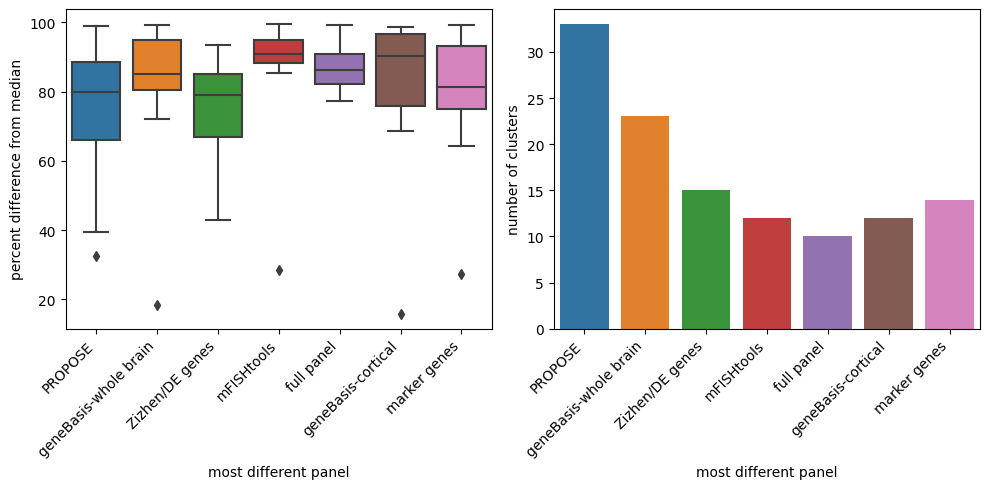

In [552]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
sns.boxplot(data=knn_cluster_df, x='most different panel', y='percent difference from median', ax=ax[0])
# ax[0].set_yscale('log')
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=45, ha='right')
sns.countplot(data=knn_cluster_df, x='most different panel', ax=ax[1])
ax[1].set_xticklabels(ax[0].get_xticklabels(), rotation=45, ha='right')
ax[1].set_ylabel('number of clusters')
plt.tight_layout()

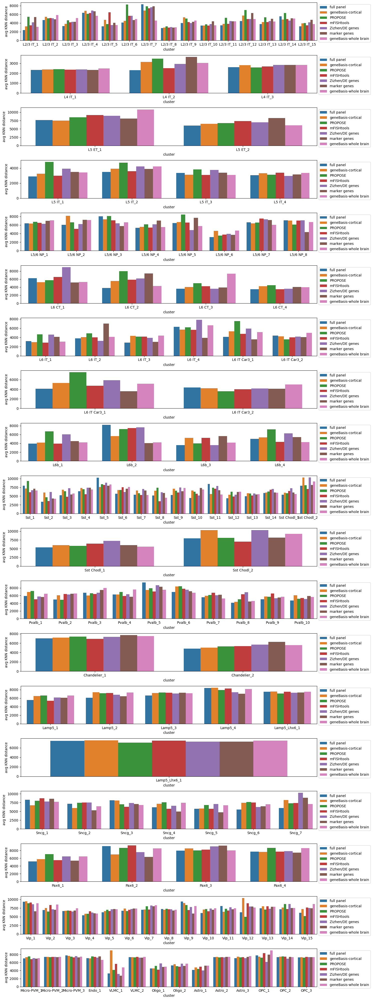

In [548]:
fig, ax = plt.subplots(19, 1, figsize=(15, 40))
ii = 0
for i, group in enumerate([exc, inh, glia]):
    group2 = [l for l in labels if l.startswith(group)]
    if i < 2:
        for subgroup in group:
            group3 = [l for l in labels if l.startswith(subgroup)]
            data = knn_cluster_df.loc(axis=0)[group3].melt(ignore_index=False, var_name='panel', value_name='avg KNN distance').reset_index(names='cluster')
            sns.barplot(data=data, x='cluster', y='avg KNN distance', hue='panel', ax=ax[ii], order=group3)
            ax[ii].legend(loc='upper left', bbox_to_anchor=(1, 1))
#             ax[ii].set_yscale('log')
            ii+=1
    else:
        data = knn_cluster_df.loc(axis=0)[group2].melt(ignore_index=False, var_name='panel', value_name='avg KNN distance').reset_index(names='cluster')
        sns.barplot(data=data, x='cluster', y='avg KNN distance', hue='panel', ax=ax[ii], order=group2)
        ax[ii].legend(loc='upper left', bbox_to_anchor=(1, 1))
#         ax[ii].set_yscale('log')
        ii+=1
        
plt.tight_layout()

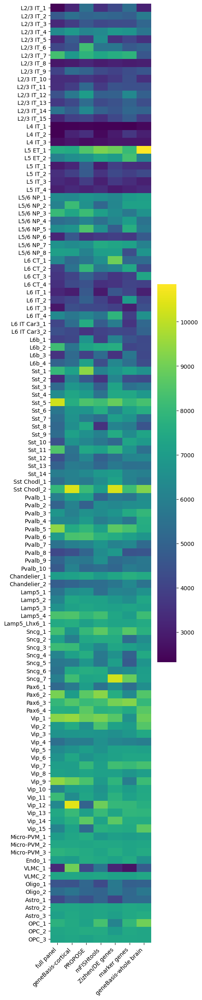

In [546]:
fig, ax = plt.subplots(figsize=(4, 30))
sns.heatmap(knn_cluster_df, cmap='viridis', ax=ax)
_ = ax.set_xticklabels(knn_cluster_df.columns, rotation=45, ha='right')

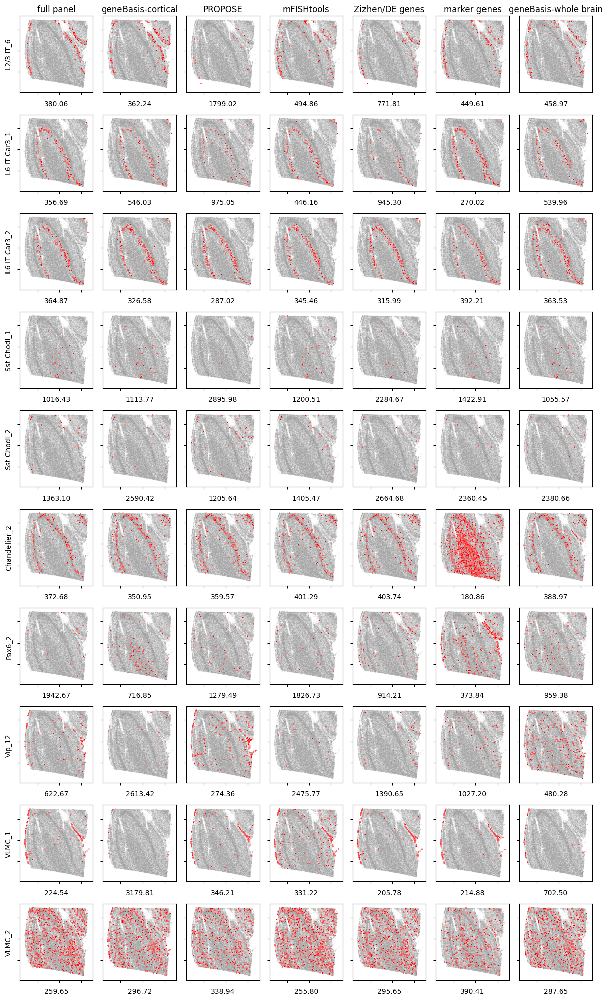

In [447]:
groups = ['L2/3 IT_6', 'L6 IT Car3_1', 'L6 IT Car3_2', 'Sst Chodl_1', 'Sst Chodl_2', 'Chandelier_2', 'Pax6_2', 'Vip_12', 'VLMC_1', 'VLMC_2']

fig, ax = plt.subplots(len(groups), 7, figsize=(12, 2*len(groups)))

for i, group in enumerate(groups):
    for j, (name, mapping) in enumerate(panel_mappings_cluster.items()):
        discrete_map = mapping.ad_sp.obsm['discrete_ct_pred']
        sns.scatterplot(data=discrete_map, x='x', y='y', s=1, color='grey', alpha=0.1, ax=ax[i,j])
        discrete_map = discrete_map[discrete_map['cluster']==group]
        sns.scatterplot(data=discrete_map, x='x', y='y', s=3, color='red', ax=ax[i,j])
        ax[i, j].set_xticklabels([])
        ax[i, j].set_yticklabels([])
        ax[i, j].set_ylabel('')
        ax[0, j].set_title(name)
        knn = knn_cluster_df.loc[group][name]
        ax[i, j].set_xlabel(f'{knn:0.2f}')
    ax[i, 0].set_ylabel(group)

plt.tight_layout()

Text(0, 0.5, 'CUX2 counts')

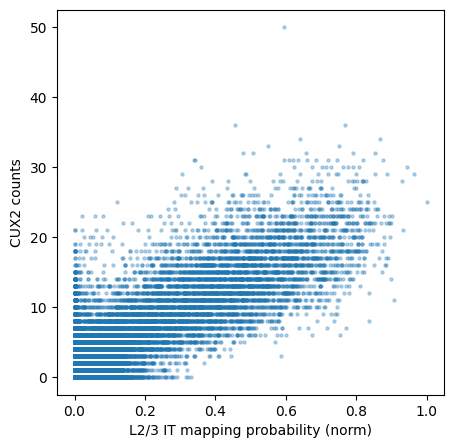

In [197]:
fig, ax = plt.subplots(figsize=(5,5))

ax.scatter(tg_vzg600.ad_sp.obsm['tangram_ct_pred_norm']['L2/3 IT'], tg_vzg600.ad_sp[:, ['cux2']].X, alpha=0.3, s=5)
ax.set_xlabel('L2/3 IT mapping probability (norm)')
ax.set_ylabel('CUX2 counts')

Text(0, 0.5, 'CUX2 counts')

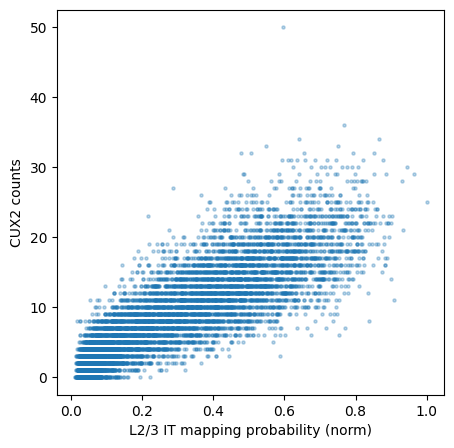

In [198]:
x = tg_vzg600.ad_sp.obsm['discrete_ct_pred'][tg_vzg600.ad_sp.obsm['discrete_ct_pred']['cluster']=='L2/3 IT']
y = tg_vzg600.ad_sp[x.index.to_list(), ['cux2']].X

fig, ax = plt.subplots(figsize=(5,5))

ax.scatter(x['cluster_prop'], y, alpha=0.3, s=5)
ax.set_xlabel('L2/3 IT mapping probability (norm)')
ax.set_ylabel('CUX2 counts')

In [505]:
sc_counts = tg_vzg600_cl.ad_sc.obs.copy()
sc_counts

,cluster,subclass,class
AACCAACGTTGTTGTG-6L8TX_191119_01_F10,Micro-PVM_1,Micro-PVM,glia
CCTCACAAGGGAGATA-5L8TX_191119_01_E10,Micro-PVM_1,Micro-PVM,glia
CACTGTCCACACACGC-3L8TX_191119_01_C10,Micro-PVM_1,Micro-PVM,glia
CAGATTGAGATTAGCA-7L8TX_191119_01_G10,Micro-PVM_1,Micro-PVM,glia
GTGTGGCTCTGCATAG-12L8TX_191126_01_D02,Micro-PVM_1,Micro-PVM,glia
...,...,...,...
CACGAATTCGTTGTTT-12L8TX_191126_01_D02,Sst_7,Sst,inh
ATTACTCTCCTTCACG-4L8TX_191119_01_D10,Sst_7,Sst,inh
CTCCTTTAGGACATCG-1L8TX_191119_01_A10,Sst_7,Sst,inh
GTACAGTAGTGCTACT-1L8TX_191119_01_A10,Sst_7,Sst,inh


In [594]:
sc_counts_class = sc_counts.groupby('class').count()
sc_counts_class.rename(columns={'cluster': 'n_cells'}, inplace=True)
sc_counts_class['percent'] = sc_counts_class.apply(lambda x: x['n_cells'] / sc_counts_class.sum()['n_cells'] * 100, axis=1)
sc_counts_class.drop(columns=['subclass'], inplace=True)
sc_counts_class

,n_cells,percent
class,,
exc,21499,43.216676
glia,5211,10.475004
inh,23037,46.308320


In [570]:
sc_counts_subclass = sc_counts.groupby(['class', 'subclass']).count()
sc_counts_subclass.rename(columns={'cluster': 'n_cells'}, inplace=True)
sc_counts_subclass['percent of class'] = sc_counts_subclass.apply(lambda x: x['n_cells'] / sc_counts_class.loc[x.name[0]]['n_cells'] * 100, axis=1)
sc_counts_subclass = sc_counts_subclass.loc[~(sc_counts_subclass==0).all(axis=1)]
sc_counts_subclass.reset_index(inplace=True)
sc_counts_subclass.set_index('subclass', inplace=True)
sc_counts_subclass

,class,n_cells,percent of class
subclass,,,
L2/3 IT,exc,8191,38.099446
L4 IT,exc,2337,10.870273
L5 ET,exc,89,0.413973
L5 IT,exc,3676,17.098470
L5/6 NP,exc,1440,6.697986
L6 CT,exc,1367,6.358435
L6 IT,exc,2045,9.512070
L6 IT Car3,exc,610,2.837341
L6b,exc,1744,8.112005


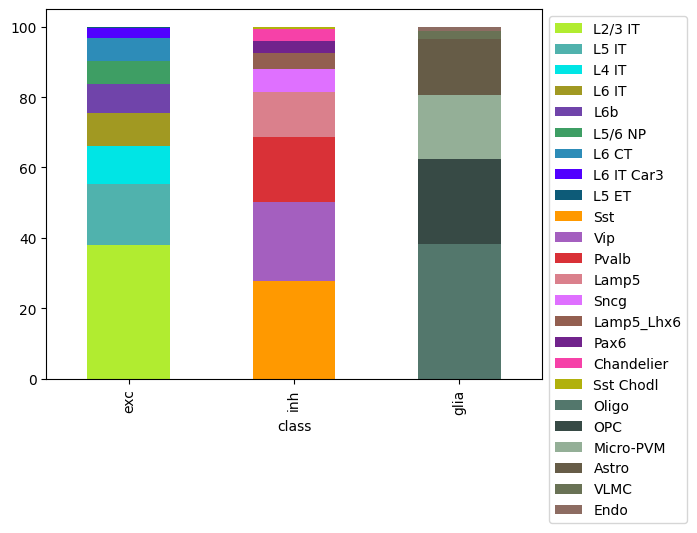

In [592]:
pivot = sc_counts_subclass.pivot_table(index=sc_counts_subclass.index, columns='class', values='percent of class')[['exc', 'inh', 'glia']]
pivot = pivot.sort_values(['exc', 'inh', 'glia'], ascending=False)
ax=pivot.T.plot.bar(stacked=True, color=ordered_labels['subclass'])
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

In [573]:
sc_counts_cluster = sc_counts.groupby(['class', 'cluster']).count()
sc_counts_cluster.rename(columns={'subclass': 'n_cells'}, inplace=True)
sc_counts_cluster['percent of class'] = sc_counts_cluster.apply(lambda x: x['n_cells'] / sc_counts_class.loc[x.name[0]]['n_cells'] * 100, axis=1)
sc_counts_cluster = sc_counts_cluster.loc[~(sc_counts_cluster==0).all(axis=1)]
sc_counts_cluster.reset_index(inplace=True)
sc_counts_cluster.set_index('cluster', inplace=True)
sc_counts_cluster.head()

,class,n_cells,percent of class
cluster,,,
L2/3 IT_1,exc,1000,4.651379
L2/3 IT_2,exc,217,1.009349
L2/3 IT_3,exc,393,1.827992
L2/3 IT_4,exc,84,0.390716
L2/3 IT_5,exc,526,2.446625


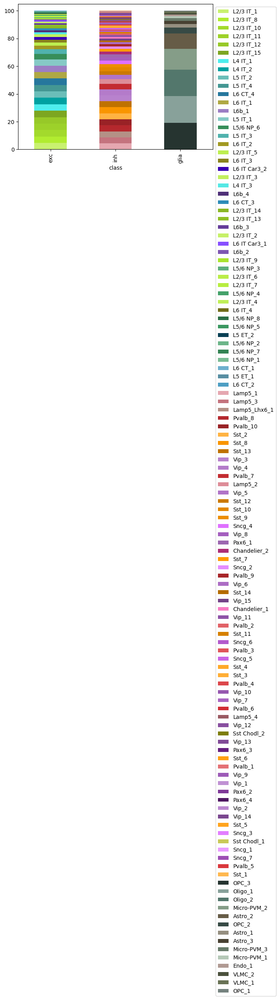

In [593]:
pivot = sc_counts_cluster.pivot_table(index=sc_counts_cluster.index, columns='class', values='percent of class')[['exc', 'inh', 'glia']]
pivot = pivot.sort_values(['exc', 'inh', 'glia'], ascending=False)
ax=pivot.T.plot.bar(stacked=True, color=ordered_labels['cluster'])
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

In [677]:
sp_counts_class_subclass = pd.DataFrame(sc_counts_class['percent'])
sp_counts_class_subclass.rename(columns={'percent': 'sc perc'}, inplace=True)
sp_counts_subclass = pd.DataFrame(sc_counts_subclass[['class', 'percent of class']])
sp_counts_subclass.rename(columns={'percent of class': 'sc perc'}, inplace=True)
for panel, mapping in panel_mappings_subclass.items():
    sp_counts = mapping.ad_sp.obsm['discrete_ct_pred']
    subclass_counts = sp_counts.groupby('cluster').count().merge(sc_counts_subclass['class'], left_index=True, right_index=True)
    class_counts = subclass_counts.groupby('class').sum()
    
    class_perc = class_counts.apply(lambda x: x / class_counts.sum() * 100, axis=1)
    class_perc.rename(columns={'x': panel + ' perc'}, inplace=True)
    sp_counts_class_subclass = sp_counts_class_subclass.merge(class_perc[panel + ' perc'], left_index=True, right_index=True)
    
    subclass_perc = subclass_counts.apply(lambda x: x['x'] / class_counts.loc[x['class']]['x'] * 100, axis=1)
    sp_counts_subclass = sp_counts_subclass.merge(pd.DataFrame(subclass_perc, columns=[panel + ' perc']), left_index=True, right_index=True)
    
sp_counts_class_subclass = sp_counts_class_subclass.loc[ordered_labels['class'].keys()]
sp_counts_subclass = sp_counts_subclass.loc[ordered_labels['subclass'].keys()]

In [678]:
sp_counts_class_subclass

,sc perc,full panel perc,geneBasis-cortical perc,PROPOSE perc,mFISHtools perc,Zizhen/DE genes perc,marker genes perc,geneBasis-whole brain perc
class,,,,,,,,
exc,43.216676,33.576630,32.295564,38.383552,31.585716,34.071018,38.149719,32.335649
inh,46.308320,24.392036,31.993252,25.349078,29.674973,26.028862,31.345203,29.357630
glia,10.475004,42.031334,35.711184,36.267370,38.739311,39.900120,30.505077,38.306721


In [680]:
sp_counts_subclass

,class,sc perc,full panel perc,geneBasis-cortical perc,PROPOSE perc,mFISHtools perc,Zizhen/DE genes perc,marker genes perc,geneBasis-whole brain perc
L2/3 IT,exc,38.099446,41.018753,38.125776,41.799748,38.379779,45.188490,41.263517,42.463843
L4 IT,exc,10.870273,16.171716,17.485519,15.208215,16.450743,15.118388,11.798958,14.994835
L5 ET,exc,0.413973,0.353181,0.279272,0.322005,0.322564,0.367665,0.249551,0.325413
L5 IT,exc,17.098470,19.350346,16.430492,18.158479,18.692824,17.971469,20.235541,16.089876
L5/6 NP,exc,6.697986,2.929911,4.975176,4.460206,4.605785,2.524634,3.331728,3.920455
L6 CT,exc,6.358435,4.496841,6.102607,3.302728,4.410132,4.279622,5.682763,6.182851
L6 IT,exc,9.512070,8.590758,8.062681,7.423524,8.349638,7.029756,8.673000,8.589876
L6 IT Car3,exc,2.837341,1.935035,1.530823,1.575214,1.702713,1.122604,2.381682,1.864669
L6b,exc,8.112005,5.153460,7.007654,7.749880,7.085823,6.397372,6.383258,5.568182
Sst,inh,27.759691,23.931800,41.728008,30.658233,29.363427,20.726386,33.596206,39.938556


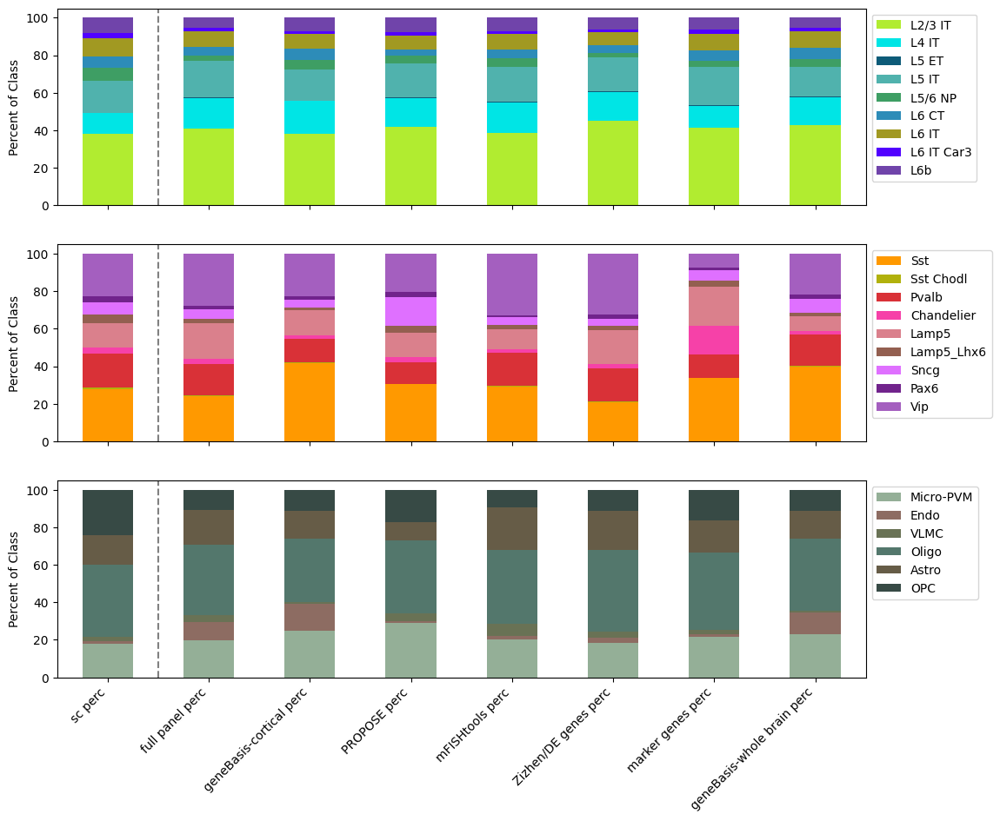

In [694]:
perc_cols = [col for col in sp_counts_subclass.columns if col.endswith('perc')]

fig, ax = plt.subplots(3, 1, figsize=(12, 10))
for i, cell_class in enumerate(['exc', 'inh', 'glia']):
    data = sp_counts_subclass[sp_counts_subclass['class']==cell_class][perc_cols]
    data.T.plot.bar(stacked=True, color=ordered_labels['subclass'], ax=ax[i])
    ax[i].set_xticklabels('')
    ax[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    ax[i].axvline(0.5, color='grey', ls='--')
    ax[i].set_ylabel('Percent of Class')

_ = ax[2].set_xticklabels(perc_cols, rotation=45, ha='right')

Text(0, 0.5, 'Percent of Class')

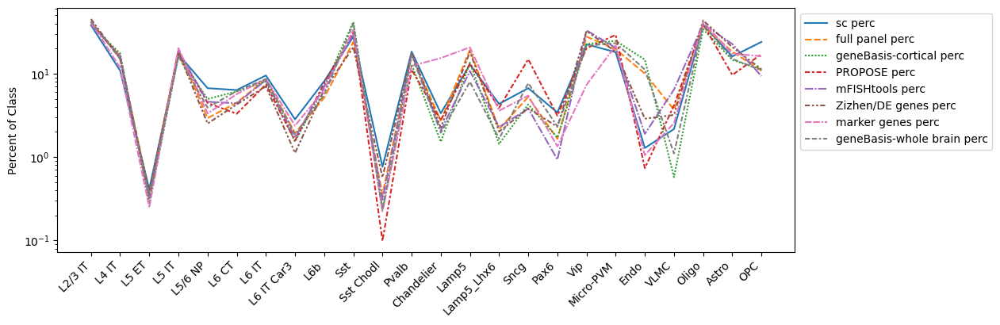

In [718]:
fig, ax = plt.subplots(figsize=(12, 4))
sns.lineplot(data=sp_counts_subclass[perc_cols], estimator=None, ax=ax)
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))
_ = ax.set_xticklabels(sp_counts_subclass.index, rotation=45, ha='right')
ax.set_yscale('log')
ax.set_ylabel('Percent of Class')

Text(0, 0.5, 'sp perc')

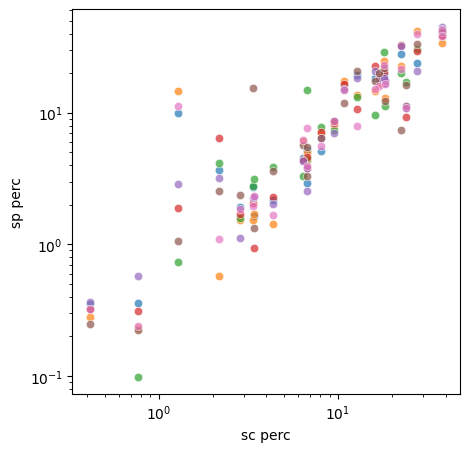

In [709]:
fig, ax = plt.subplots(figsize=(5,5))

for panel in perc_cols:
    if panel == 'sc perc':
        continue
    sns.scatterplot(data=sp_counts_subclass, x='sc perc', y=panel, ax=ax, alpha=0.7, lw=0, legend=True)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_ylabel('sp perc')

In [711]:
sp_counts_class_cluster = pd.DataFrame(sc_counts_class['percent'])
sp_counts_class_cluster.rename(columns={'percent': 'sc perc'}, inplace=True)
sp_counts_cluster = pd.DataFrame(sc_counts_cluster[['class', 'percent of class']])
sp_counts_cluster.rename(columns={'percent of class': 'sc perc'}, inplace=True)
for panel, mapping in panel_mappings_cluster.items():
    sp_counts = mapping.ad_sp.obsm['discrete_ct_pred']
    cluster_counts = sp_counts.groupby('cluster').count().merge(sc_counts_cluster['class'], left_index=True, right_index=True)
    class_counts = cluster_counts.groupby('class').sum()
    
    class_perc = class_counts.apply(lambda x: x / class_counts.sum() * 100, axis=1)
    class_perc.rename(columns={'x': panel + ' perc'}, inplace=True)
    sp_counts_class_cluster = sp_counts_class_cluster.merge(class_perc[panel + ' perc'], left_index=True, right_index=True)
    
    cluster_perc = cluster_counts.apply(lambda x: x['x'] / class_counts.loc[x['class']]['x'] * 100, axis=1)
    sp_counts_cluster = sp_counts_cluster.merge(pd.DataFrame(cluster_perc, columns=[panel + ' perc']), left_index=True, right_index=True)
    
sp_counts_class_clsuter = sp_counts_class_cluster.loc[ordered_labels['class'].keys()]
sp_counts_cluster = sp_counts_cluster.loc[ordered_labels['cluster'].keys()]

In [712]:
sp_counts_class_cluster

,sc perc,full panel perc,geneBasis-cortical perc,PROPOSE perc,mFISHtools perc,Zizhen/DE genes perc,marker genes perc,geneBasis-whole brain perc
class,,,,,,,,
exc,43.216676,38.437961,35.569794,38.547782,36.028375,34.534397,40.285088,33.890936
glia,10.475004,45.934626,44.567506,36.543809,45.527716,44.820821,35.906433,41.643678
inh,46.308320,15.627413,19.862700,24.908409,18.443909,20.644782,23.808480,24.465385


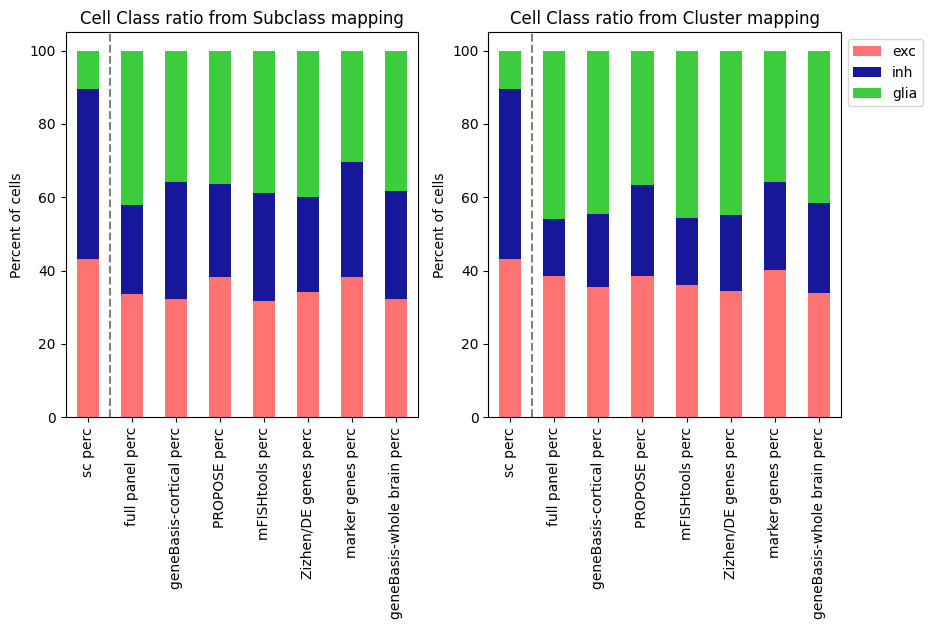

In [717]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))

sp_counts_class_subclass.T[['exc', 'inh', 'glia']].plot.bar(stacked=True, color=ordered_labels['class'], ax=ax[0], legend=False)
# ax[0].legend(loc='upper left', bbox_to_anchor=(1, 1))
ax[0].set_ylabel('Percent of cells')
ax[0].set_title('Cell Class ratio from Subclass mapping')
ax[0].axvline(0.5, color='grey', ls='--')

sp_counts_class_cluster.T[['exc', 'inh', 'glia']].plot.bar(stacked=True, color=ordered_labels['class'], ax=ax[1])
ax[1].legend(loc='upper left', bbox_to_anchor=(1, 1))
ax[1].set_ylabel('Percent of cells')
ax[1].set_title('Cell Class ratio from Cluster mapping')
ax[1].axvline(0.5, color='grey', ls='--')

In [118]:
map_compare = fraction_mapped['cluster']
map_compare.set_index('celltype', inplace=True)
map_compare.rename(columns={'frac_correctly_mapped': 'gene_basis_prediction'}, inplace=True)
map_compare.head()

,gene_basis_prediction
celltype,
Astro_1,0.88
Astro_2,0.71
Astro_3,0.64
Chandelier_1,0.93
Chandelier_2,0.88


In [119]:
tg_median_map = tg_map_cluster.ad_sp.obsm['discrete_ct_pred'].groupby('cluster').median()
map_compare = map_compare.merge(tg_median_map['cluster_prop'], left_index=True, right_index=True)
map_compare.rename(columns={'cluster_prop': 'tangram_mapping_probability'}, inplace=True)
# map_compare['class'] = map_compare.apply(lambda x: assign_class(x), axis=1)
map_compare.head()

,gene_basis_prediction,tangram_mapping_probability
Astro_1,0.88,0.225568
Astro_2,0.71,0.261061
Astro_3,0.64,0.305119
Chandelier_1,0.93,0.485499
Chandelier_2,0.88,0.467712


In [63]:
norm_map_compare = (map_compare-map_compare.min())/(map_compare.max()-map_compare.min())
norm_map_compare['diff'] = norm_map_compare.apply(lambda x: x['tangram_mapping_probability'] - x['gene_basis_prediction'],axis=1)
norm_map_compare = norm_map_compare.loc[list(tg_map_cluster.celltype_labels['cluster'].keys())]
norm_map_compare.head()

,gene_basis_prediction,tangram_mapping_probability,diff
L2/3 IT_1,0.000000,0.455964,0.455964
L2/3 IT_2,0.525641,0.519839,-0.005802
L2/3 IT_3,0.410256,0.521409,0.111153
L2/3 IT_4,0.664225,0.718249,0.054024
L2/3 IT_5,0.858974,0.430234,-0.428740


<AxesSubplot: xlabel='gene_basis_prediction', ylabel='tangram_mapping_probability'>

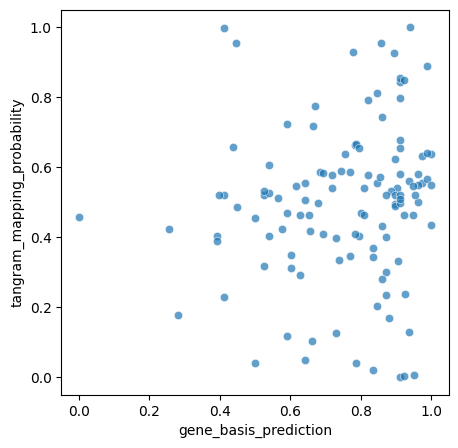

In [64]:
fig, ax = plt.subplots(figsize=(5,5))

sns.scatterplot(data=norm_map_compare, x='gene_basis_prediction', y='tangram_mapping_probability', ax=ax, alpha=0.7, lw=0)


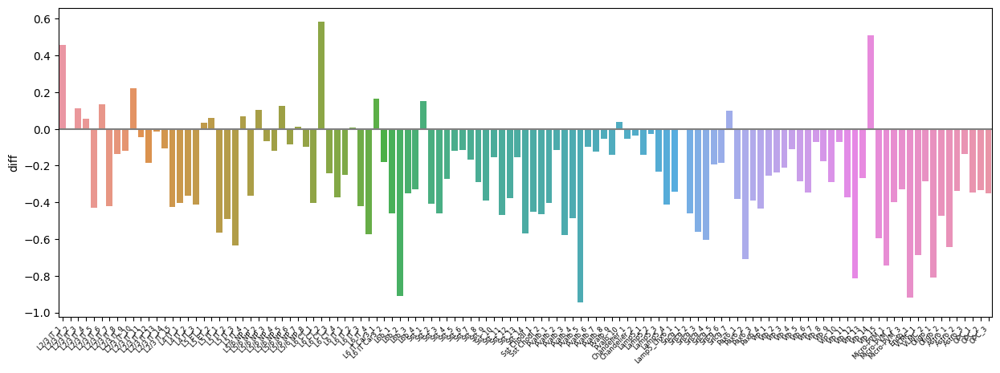

In [65]:
fig, ax = plt.subplots(figsize=(15, 5))
sns.barplot(data=norm_map_compare, y='diff', x=norm_map_compare.index, ax=ax)
ax.set_xticklabels(norm_map_compare.index, rotation=45, size=6, ha='right')
ax.axhline(0, color='grey')

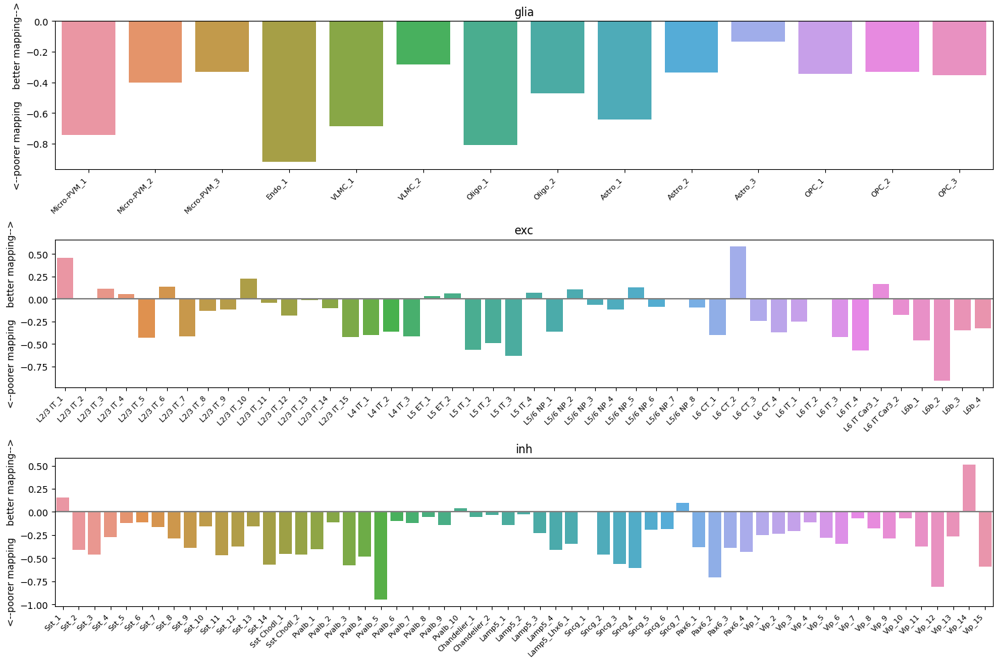

In [131]:
class_groups = tg_map_cluster.ad_sc.obs['class'].unique()
groups = {group: tg_map_cluster.ad_sc.obs[tg_map_cluster.ad_sc.obs['class']==(group)]['cluster'].unique().to_list() for group in class_groups}

fig, ax =  plt.subplots(3, 1, figsize=(15, 10))
for i, (group_name, group) in enumerate(groups.items()):
    subdata = norm_map_compare[norm_map_compare.index.isin(group)]
    sns.barplot(data=subdata, x=subdata.index, y='diff', ax=ax[i])
    _ = ax[i].set_xticklabels(subdata.index, rotation=45, size=8, ha='right')
    ax[i].set_title(group_name)
    ax[i].axhline(0, color='grey')
    ax[i].set_ylabel('<--poorer mapping    better mapping-->')

plt.tight_layout()

In [169]:
subclass = fraction_mapped['subclass'].copy()
subclass.set_index('celltype', inplace=True)
subclass = subclass.loc[tg_map.celltype_labels['subclass'].keys()]
subclass

,frac_correctly_mapped
celltype,
L2/3 IT,0.997305
L4 IT,0.980000
L5 ET,0.977528
L5 IT,0.970000
L5/6 NP,0.996727
L6 CT,0.996269
L6 IT,0.997375
L6 IT Car3,0.995000
L6b,0.987500


Text(0.5, 0, 'subclass')

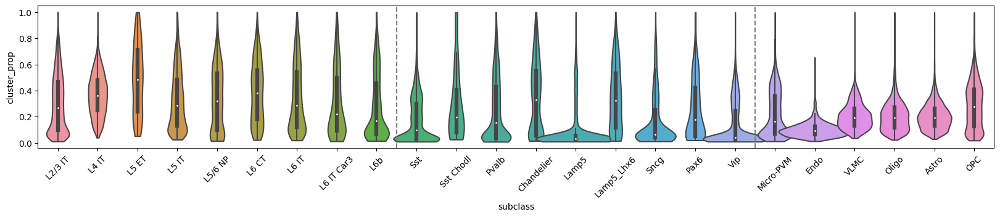

In [156]:
fig, ax = plt.subplots(figsize=(20, 3))
sns.violinplot(data=tg_map.ad_sp.obsm['discrete_ct_pred'], x='cluster', y='cluster_prop', ax=ax, cut=0, width=2,
               order=tg_map.celltype_labels['subclass'].keys())
ax.tick_params(axis='x', labelrotation = 45)
ax.axvline(8.5, c='grey', ls='--')
ax.axvline(17.5, c='grey', ls='--')
ax.set_xlabel('subclass')

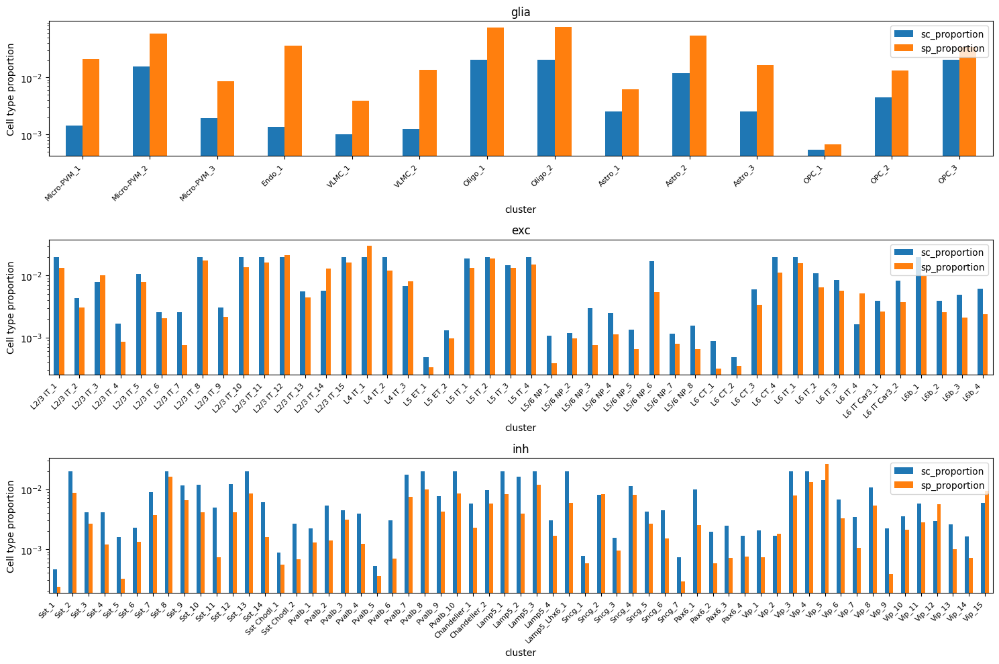

In [111]:
# discrete cell mapping with no threshold

# class_groups = tg_map_cluster.ad_sc.obs['class'].unique()
# groups = {group: tg_map_cluster.ad_sc.obs[tg_map_cluster.ad_sc.obs['class']==(group)]['cluster'].unique().to_list() for group in class_groups}

# fig, ax =  plt.subplots(3, 1, figsize=(15, 10))
# for i, (group_name, group) in enumerate(groups.items()):
#     subdata = proportions[proportions.index.isin(group)]
#     subdata.reset_index().plot(x='cluster', y=['sc_proportion', 'sp_proportion'], kind='bar', ax=ax[i])
#     _ = ax[i].set_xticklabels(subdata.index, rotation=45, size=8, ha='right')
#     ax[i].set_yscale('log')
#     ax[i].set_title(group_name)
#     ax[i].set_ylabel('Cell type proportion')

# plt.tight_layout()

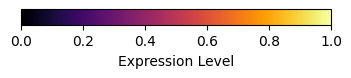

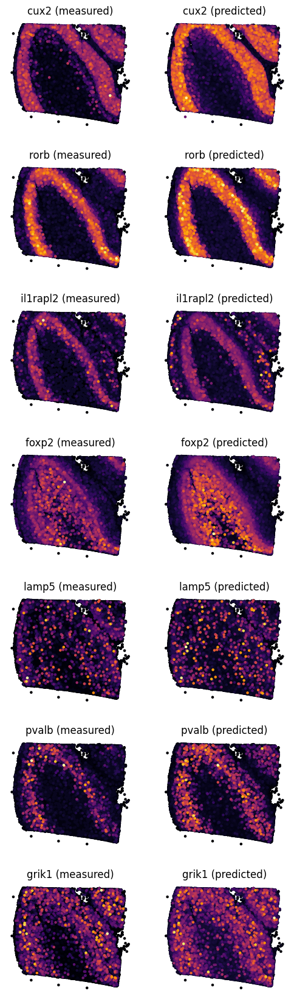

In [139]:
import tangram as tg
genes = ['CUX2', 'RORB', 'IL1RAPL2', 'FOXP2', 'LAMP5', 'PVALB', 'GRIK1']
genes = [g.lower() for g in genes]
tg.plot_genes(genes, tg_map_cluster.ad_sp, tg_map_cluster.ad_ge, invert_y=False)

In [167]:
subclass_map = tg_vzg600.ad_sp.obsm['discrete_ct_pred']
subclass_map.head()

,x,y,cluster_prop,cluster
cell,,,,
1019095826100270249,3895.770335,625.912326,0.356975,Micro-PVM
1019095826100300124,5750.175333,436.002554,0.088328,Micro-PVM
1019095826100310136,6295.305789,813.067863,0.240196,Oligo
1019095826100310139,6278.814060,820.291813,0.228403,Oligo
1019095826100310140,6263.352582,823.191133,0.296514,Astro


In [168]:
l23_it = subclass_map[subclass_map['cluster']=='L2/3 IT']
l23_it.head()

,x,y,cluster_prop,cluster
cell,,,,
1019095826100330116,7271.432258,719.899959,0.032612,L2/3 IT
1019095826100330180,7264.388633,783.142541,0.058633,L2/3 IT
1019095826100330271,7197.086143,861.651629,0.020940,L2/3 IT
1019095826100330299,6932.802329,895.061424,0.034584,L2/3 IT
1019095826100340054,7555.153883,570.471406,0.022542,L2/3 IT


In [169]:
from sklearn.neighbors import NearestNeighbors

In [171]:
X = l23_it[['x', 'y']].to_numpy()
nbrs = NearestNeighbors(n_neighbors=10, algorithm='ball_tree').fit(X)
distances, indices = nbrs.kneighbors(X)

In [173]:
distances[:,1:].mean()

59.290026127321006

In [207]:
knn_subclass_df.melt(ignore_index=False)

,variable,value
Micro-PVM,vzg600,102.585498
Oligo,vzg600,56.985076
Astro,vzg600,108.248741
VLMC,vzg600,236.187480
OPC,vzg600,140.691006
...,...,...
L5 IT,whole brain,68.493020
Pax6,whole brain,343.555014
L5 ET,whole brain,686.787315
L4 IT,whole brain,59.340765


<AxesSubplot: xlabel='x', ylabel='y'>

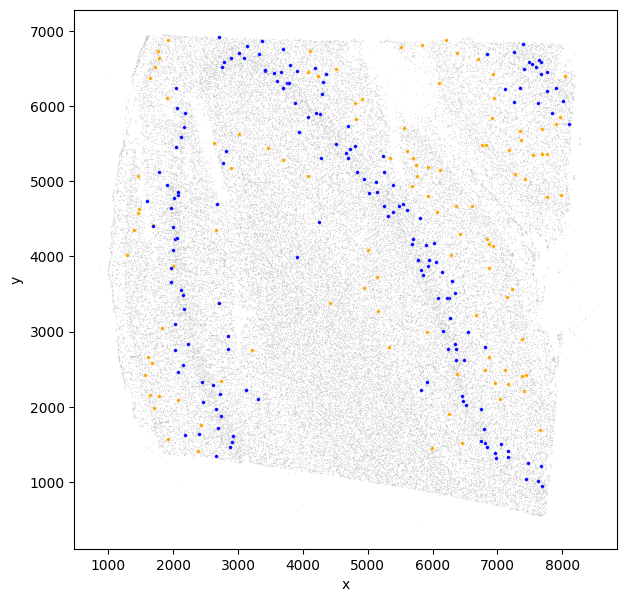

In [96]:
fig, ax = plt.subplots(figsize=(7, 7))
discrete_map = tg_vzg600_cl.ad_sp.obsm['discrete_ct_pred']
sns.scatterplot(data=discrete_map, x='x', y='y', s=1, color='grey', alpha=0.2, ax=ax)
chc1 = discrete_map[discrete_map['cluster']=='Chandelier_1']
sns.scatterplot(data=chc1, x='x', y='y', s=7, color='orange', ax=ax)
chc2 = discrete_map[discrete_map['cluster']=='Chandelier_2']
sns.scatterplot(data=chc2, x='x', y='y', s=7, color='blue', ax=ax)

<AxesSubplot: xlabel='x', ylabel='y'>

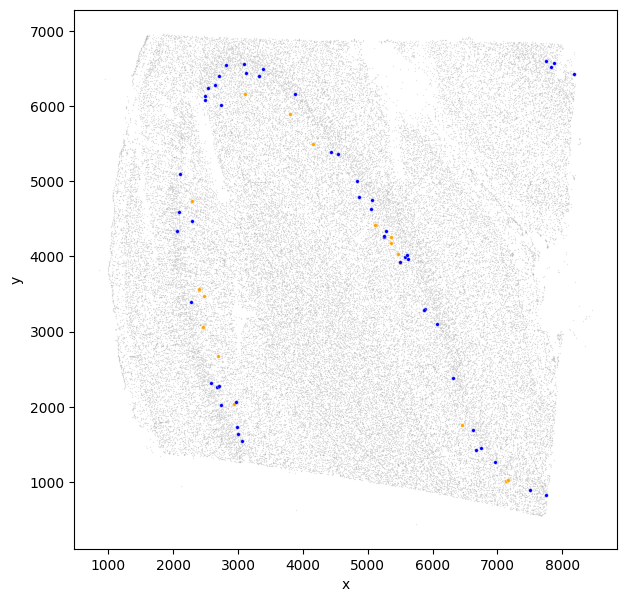

In [97]:
fig, ax = plt.subplots(figsize=(7, 7))
discrete_map = tg_vzg600_cl.ad_sp.obsm['discrete_ct_pred']
sns.scatterplot(data=discrete_map, x='x', y='y', s=1, color='grey', alpha=0.2, ax=ax)
l5et1 = discrete_map[discrete_map['cluster']=='L5 ET_1']
sns.scatterplot(data=l5et1, x='x', y='y', s=7, color='orange', ax=ax)
l5et2 = discrete_map[discrete_map['cluster']=='L5 ET_2']
sns.scatterplot(data=l5et2, x='x', y='y', s=7, color='blue', ax=ax)

In [112]:
genes = tg_vzg600.ad_sp.var_names

In [148]:
chc1_genes = [
'BRINP3',
'CHRM3',
'GRIK1',
'LOC106993406',
'PDZRN4',
'PRKG1',
'RBM20',
'SLC35F4',
'SLC44A5',
'SULF1',
'TMEM108',
]

chc2_genes = [
'ADRA1A',
'CDH6',
'CNTN3',
'COL25A1',
'CRTAC1',
'CTSC',
'DCLK1',
'DMD',
'GALNTL6',
'HDAC9',
'HTR1E',
'IL1RAPL2',
'KCNIP1',
'LGI1',
'LINGO2',
'LOC114676844',
'METAP1D',
'NKAIN2',
'NLGN1',
'NYAP2',
'PCDH17',
'PDE1C',
'PTPRK',
'RAB27B',
'RGS6',
'TAFA1',
'TAFA4',
'UST',
'ZNF804B',  
]

In [274]:
chc_genes = [g.lower() for g in chc1_genes + chc2_genes if g.lower() in genes]
chc_genes

['brinp3',
 'chrm3',
 'grik1',
 'pdzrn4',
 'prkg1',
 'tmem108',
 'adra1a',
 'cdh6',
 'col25a1',
 'crtac1',
 'dmd',
 'galntl6',
 'hdac9',
 'htr1e',
 'il1rapl2',
 'kcnip1',
 'lingo2',
 'nkain2',
 'nlgn1',
 'pde1c',
 'ptprk',
 'rgs6',
 'tafa1',
 'znf804b']

In [275]:
chc = tg_vzg600_cl.ad_sp.obsm['discrete_ct_pred'][tg_vzg600_cl.ad_sp.obsm['discrete_ct_pred']['cluster'].isin(['Chandelier_1', 'Chandelier_2'])]
gene_exp = tg_vzg600_cl.ad_sp[chc.index.to_list(), chc_genes].X
cols = chc.columns.to_list() + chc_genes

In [276]:
chc = pd.concat([chc.reset_index(), pd.DataFrame(gene_exp)], ignore_index=True, axis=1)
chc.set_index(0, inplace=True)
chc.columns = cols
chc

,x,y,cluster_prop,cluster,brinp3,chrm3,grik1,pdzrn4,prkg1,tmem108,...,il1rapl2,kcnip1,lingo2,nkain2,nlgn1,pde1c,ptprk,rgs6,tafa1,znf804b
0,,,,,,,,,,,,,,,,,,,,,
1019095826100430078,2666.233708,1342.426004,0.621363,Chandelier_2,4.0,1.0,21.0,2.0,5.0,7.0,...,0.0,1.0,1.0,0.0,2.0,0.0,0.0,0.0,2.0,1.0
1019095826100520525,6983.877719,1322.029179,0.195435,Chandelier_2,1.0,2.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1019095826100520536,7156.962904,1332.458966,0.321039,Chandelier_2,8.0,4.0,6.0,1.0,4.0,1.0,...,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,1.0
1019095826100530119,7689.994529,949.835736,0.374145,Chandelier_2,3.0,3.0,5.0,2.0,4.0,1.0,...,0.0,2.0,0.0,0.0,2.0,0.0,4.0,3.0,1.0,0.0
1019095826100530197,7631.125650,1011.797108,0.468411,Chandelier_2,4.0,2.0,2.0,1.0,4.0,0.0,...,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1019095826102780122,6210.158555,6884.123477,0.504628,Chandelier_1,3.0,0.0,0.0,0.0,1.0,1.0,...,0.0,1.0,0.0,0.0,3.0,6.0,0.0,0.0,1.0,1.0
1019095826102810034,7258.108764,6724.968086,0.628367,Chandelier_2,8.0,6.0,5.0,2.0,2.0,1.0,...,0.0,0.0,1.0,0.0,2.0,1.0,0.0,0.0,1.0,1.0
1019095826102810157,7391.188802,6826.194543,0.379870,Chandelier_2,3.0,5.0,10.0,4.0,1.0,2.0,...,0.0,2.0,0.0,0.0,1.0,0.0,0.0,0.0,4.0,1.0


<AxesSubplot: xlabel='BRINP3', ylabel='ADRA1A'>

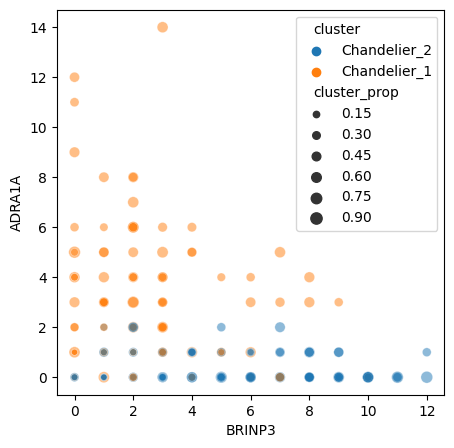

In [194]:
fig, ax = plt.subplots(figsize=(5,5))

sns.scatterplot(data=chc, x='BRINP3', y='ADRA1A', hue='cluster', size='cluster_prop', ax=ax, alpha=0.5)

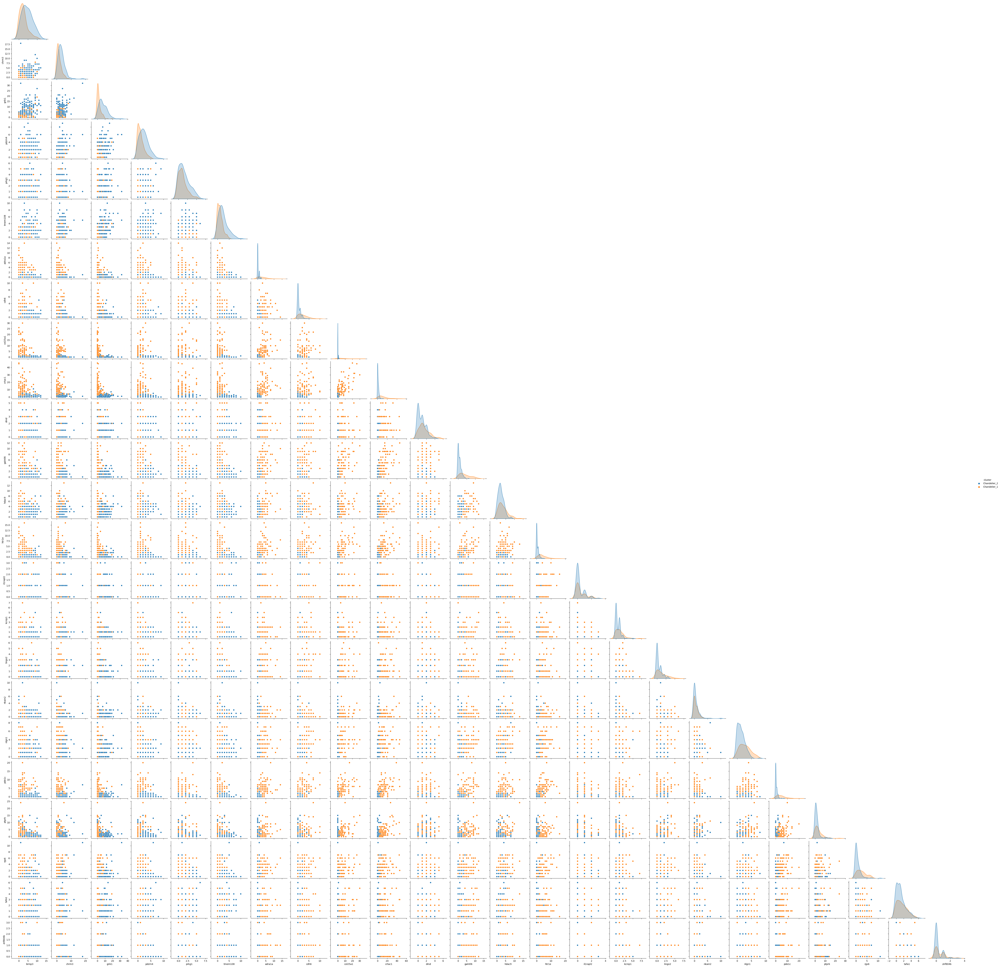

In [278]:
sns.pairplot(data=chc, vars=chc_genes, hue='cluster', corner=True)

In [497]:
car3_genes = ['cux2', 'htr2c', 'ldb2']
car3 = tg_vzg600_cl.ad_sp.obsm['discrete_ct_pred'][tg_vzg600_cl.ad_sp.obsm['discrete_ct_pred']['cluster'].isin(['L6 IT Car3_1', 'L6 IT Car3_2'])]
gene_exp = tg_vzg600_cl.ad_sp[car3.index.to_list(), car3_genes].X
cols = car3.columns.to_list() + car3_genes

car3 = pd.concat([car3.reset_index(), pd.DataFrame(gene_exp)], ignore_index=True, axis=1)
car3.set_index(0, inplace=True)
car3.columns = cols
car3.head()

,x,y,cluster_prop,cluster,cux2,htr2c,ldb2
0,,,,,,,
1019095826100330129,7205.091575,731.813707,0.251644,L6 IT Car3_1,5.0,0.0,0.0
1019095826100330142,7200.675966,742.316617,0.262538,L6 IT Car3_1,9.0,0.0,1.0
1019095826100330147,7190.168408,747.238315,0.172945,L6 IT Car3_1,8.0,0.0,2.0
1019095826100330211,7258.738306,814.617265,0.208200,L6 IT Car3_1,7.0,0.0,0.0
1019095826100330212,7272.221750,816.879452,0.335814,L6 IT Car3_2,10.0,1.0,0.0


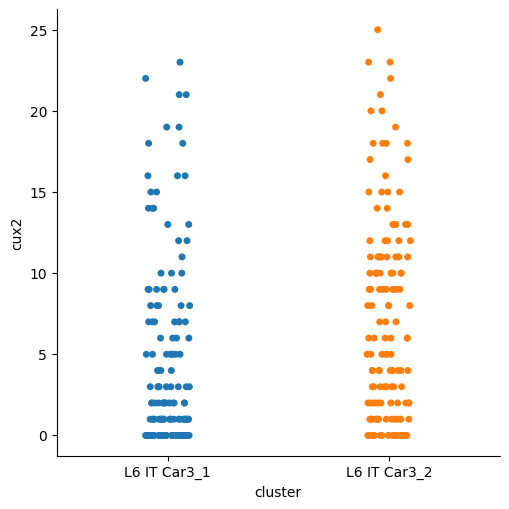

In [490]:
sns.catplot(data=car3, y='cux2', x='cluster')

<AxesSubplot: xlabel='cux2', ylabel='Count'>

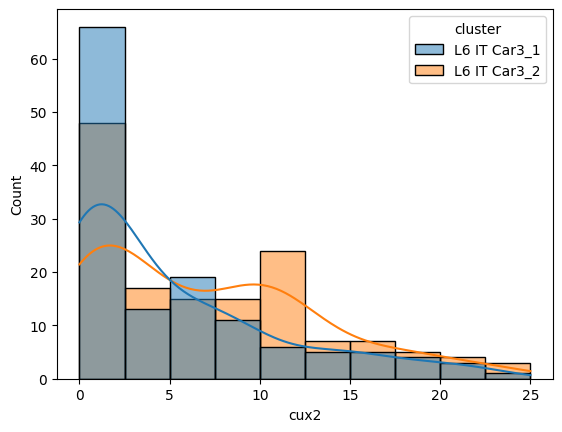

In [495]:
sns.histplot(data=car3, x='cux2', hue='cluster', kde=True)

<AxesSubplot: xlabel='x', ylabel='y'>

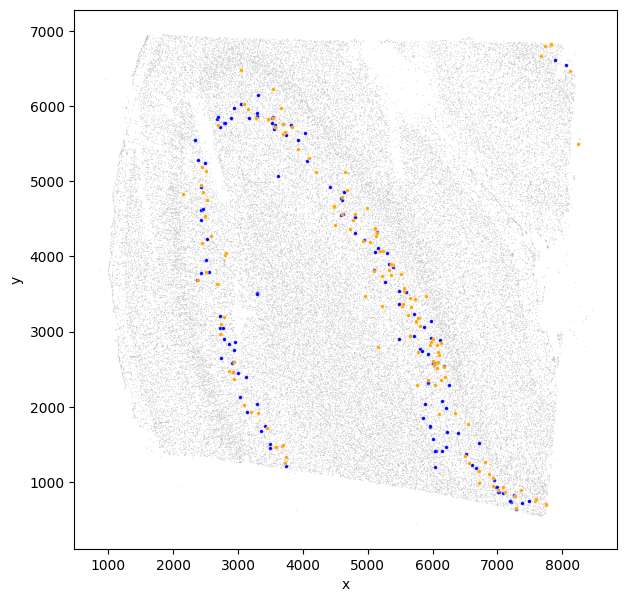

In [500]:
fig, ax = plt.subplots(figsize=(7, 7))
discrete_map = tg_vzg600_cl.ad_sp.obsm['discrete_ct_pred']
sns.scatterplot(data=discrete_map, x='x', y='y', s=1, color='grey', alpha=0.2, ax=ax)
car31 = discrete_map[discrete_map['cluster']=='L6 IT Car3_1']
sns.scatterplot(data=car31, x='x', y='y', s=7, color='blue', ax=ax)
car32 = discrete_map[discrete_map['cluster']=='L6 IT Car3_2']
sns.scatterplot(data=car32, x='x', y='y', s=7, color='orange', ax=ax)

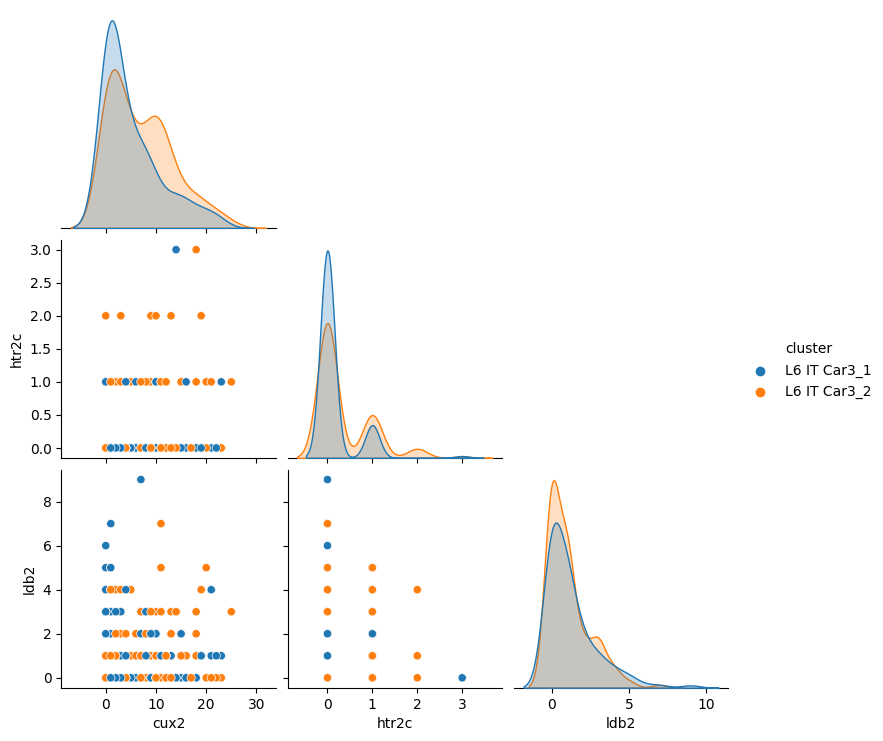

In [498]:
sns.pairplot(data=car3, vars=car3_genes, hue='cluster', corner=True)